## <span style="color: Red;">Finance and Risk Analytics</span>

## *<span style="color: Red;">Objective</span>*
### To construct, evaluate, and optimize two distinct investment portfolios—an aggressive and a conservative one—based on historical stock data and market performance.

## <span style="color: green;">Loading Data

In [1]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Loading all stock data files (each company has its own CSV in a folder)
folder_path1 = r"C:\Users\ushik\Downloads\Dataset\Aviation"
folder_path2 = r"C:\Users\ushik\Downloads\Dataset\Finance"
folder_path3 = r"C:\Users\ushik\Downloads\Dataset\Pharma_Healthcare"
folder_path4 = r"C:\Users\ushik\Downloads\Dataset\Technology"

In [3]:
# List of folders containing the sector data (use variables, not strings)
sector_folders = [folder_path1, folder_path2, folder_path3, folder_path4]

# Initialize an empty list to store DataFrames from all sectors
all_stock_data = []

# Loop through each folder and read CSV files
for folder_path in sector_folders:
    if os.path.exists(folder_path):  # Check if folder path exists
        for file in os.listdir(folder_path):
            if file.endswith(".csv"):
                df = pd.read_csv(os.path.join(folder_path, file))
                # Add a column for the company name (from file name)
                df['Company'] = file.split('.')[0]  
                all_stock_data.append(df)
    else:
        print(f"Folder does not exist: {folder_path}")

# Concatenate all DataFrames into a single DataFrame
stock_df = pd.concat(all_stock_data, ignore_index=True)

In [4]:
# Check the combined DataFrame
print(stock_df.head())

         Date  Open  High   Low  Close  Adj Close     Volume Company
0  01-10-2010  9.29  9.39  9.21   9.29   8.758067  3603800.0     AAL
1  04-10-2010  9.24  9.48  9.05   9.12   8.597802  3856800.0     AAL
2  05-10-2010  9.27  9.35  9.15   9.23   8.701504  3896600.0     AAL
3  06-10-2010  9.27  9.40  9.15   9.23   8.701504  3230200.0     AAL
4  07-10-2010  9.30  9.31  9.07   9.24   8.710930  3877700.0     AAL


In [5]:
print(stock_df['Company'].unique())  # To ensure all companies are included

['AAL' 'ALGT' 'ALK' 'DAL' 'HA' 'LUV' 'BCS' 'CS' 'DB' 'GS' 'MS' 'WFC' 'BHC'
 'JNJ' 'MRK' 'PFE' 'RHHBY' 'UNH' 'AAPL' 'AMZN' 'FB' 'GOOG' 'IBM' 'MSFT']


In [6]:
# Load S&P 500 data
sp500_df = pd.read_csv(R"C:\Users\ushik\Downloads\Dataset\S&P500.csv")

sp500_df.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,01-10-2010,1143.489990,1150.300049,1139.420044,1146.239990,1146.239990,4298910000
1,04-10-2010,1144.959961,1148.160034,1131.869995,1137.030029,1137.030029,3604110000
2,05-10-2010,1140.680054,1162.760010,1140.680054,1160.750000,1160.750000,4068840000
3,06-10-2010,1159.810059,1162.329956,1154.849976,1159.969971,1159.969971,4073160000
4,07-10-2010,1161.569946,1163.869995,1151.410034,1158.060059,1158.060059,3910550000


## <span style="color: green;">Merging Data Files

In [7]:
# Merge stock data with S&P 500 index data on 'Date'
combined_df = pd.merge(stock_df, sp500_df[['Date', 'Close']], on='Date', how='left', suffixes=('', '_SP500'))

combined_df.head()

,Date,Open,High,Low,Close,Adj Close,Volume,Company,Close_SP500
0,01-10-2010,9.29,9.39,9.21,9.29,8.758067,3603800.0,AAL,1146.239990
1,04-10-2010,9.24,9.48,9.05,9.12,8.597802,3856800.0,AAL,1137.030029
2,05-10-2010,9.27,9.35,9.15,9.23,8.701504,3896600.0,AAL,1160.750000
3,06-10-2010,9.27,9.40,9.15,9.23,8.701504,3230200.0,AAL,1159.969971
4,07-10-2010,9.30,9.31,9.07,9.24,8.710930,3877700.0,AAL,1158.060059


## <span style="color: green;"> Exploring Data

In [8]:
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61285 entries, 0 to 61284
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Date         61125 non-null  object 
 1   Open         61125 non-null  float64
 2   High         61125 non-null  float64
 3   Low          61125 non-null  float64
 4   Close        61125 non-null  float64
 5   Adj Close    61125 non-null  float64
 6   Volume       61125 non-null  float64
 7   Company      61285 non-null  object 
 8   Close_SP500  59997 non-null  float64
dtypes: float64(7), object(2)
memory usage: 4.2+ MB


In [9]:
combined_df.describe()

,Open,High,Low,Close,Adj Close,Volume,Close_SP500
count,61125.000000,61125.000000,61125.000000,61125.000000,61125.000000,6.112500e+04,59997.000000
mean,124.044092,125.305156,122.716344,124.050000,119.024035,2.050457e+07,2117.096752
std,268.162566,271.001096,265.076749,268.173846,268.620223,6.680157e+07,610.268732
min,3.450000,3.880000,3.410000,3.780000,3.642072,0.000000e+00,1099.229980
25%,26.540001,26.870001,26.209999,26.540001,22.815945,2.097300e+06,1582.239990
50%,46.119999,46.650002,45.570000,46.119999,42.078094,5.193400e+06,2075.000000
75%,119.779999,121.129997,118.400002,119.750000,111.446587,1.361290e+07,2659.989990
max,3547.000000,3552.250000,3486.689941,3531.449951,3531.449951,1.880998e+09,3580.840088


In [10]:
# Use describe() and round the result to 2 decimal places
rounded_stats = combined_df.describe().round(2)

# Display the rounded statistics
rounded_stats

,Open,High,Low,Close,Adj Close,Volume,Close_SP500
count,61125.00,61125.00,61125.00,61125.00,61125.00,6.112500e+04,59997.00
mean,124.04,125.31,122.72,124.05,119.02,2.050457e+07,2117.10
std,268.16,271.00,265.08,268.17,268.62,6.680157e+07,610.27
min,3.45,3.88,3.41,3.78,3.64,0.000000e+00,1099.23
25%,26.54,26.87,26.21,26.54,22.82,2.097300e+06,1582.24
50%,46.12,46.65,45.57,46.12,42.08,5.193400e+06,2075.00
75%,119.78,121.13,118.40,119.75,111.45,1.361290e+07,2659.99
max,3547.00,3552.25,3486.69,3531.45,3531.45,1.880998e+09,3580.84


## <span style="color: green;">Checking for Missing Values and Replacing them with Forward Fill

In [11]:
# Check for missing values in the entire DataFrame
missing_values = combined_df.isnull().sum()

# Display missing values for each column
print(missing_values)

Date            160
Open            160
High            160
Low             160
Close           160
Adj Close       160
Volume          160
Company           0
Close_SP500    1288
dtype: int64


In [12]:
# Forward fill (using the previous value) as it is a time-series data
combined_df.fillna(method='ffill', inplace=True)

In [13]:
combined_df.isnull().sum()

Date           0
Open           0
High           0
Low            0
Close          0
Adj Close      0
Volume         0
Company        0
Close_SP500    0
dtype: int64

In [14]:
# Getting the stats again after replacing the missing values

combined_df.describe().round(2)

,Open,High,Low,Close,Adj Close,Volume,Close_SP500
count,61285.00,61285.00,61285.00,61285.00,61285.00,6.128500e+04,61285.00
mean,124.46,125.73,123.13,124.47,119.45,2.047643e+07,2143.28
std,270.17,273.08,267.10,270.19,270.64,6.671890e+07,629.71
min,3.45,3.88,3.41,3.78,3.64,0.000000e+00,1099.23
25%,26.53,26.86,26.21,26.53,22.82,2.097600e+06,1606.28
50%,46.12,46.65,45.57,46.12,42.09,5.188700e+06,2080.41
75%,119.99,121.40,118.62,119.90,111.71,1.361590e+07,2697.79
max,3547.00,3552.25,3486.69,3531.45,3531.45,1.880998e+09,3580.84


## <span style="color: green;">Analyzing and Visualising Data for Insights

In [15]:
import plotly.express as px
import plotly.graph_objects as go

### *<span style="color: red;">Stock Price Over Time (Line Chart)</span>*: This visualization will show the adjusted closing price of each stock over time.

In [16]:
# Get unique stock names
stock_names = combined_df['Company'].unique()

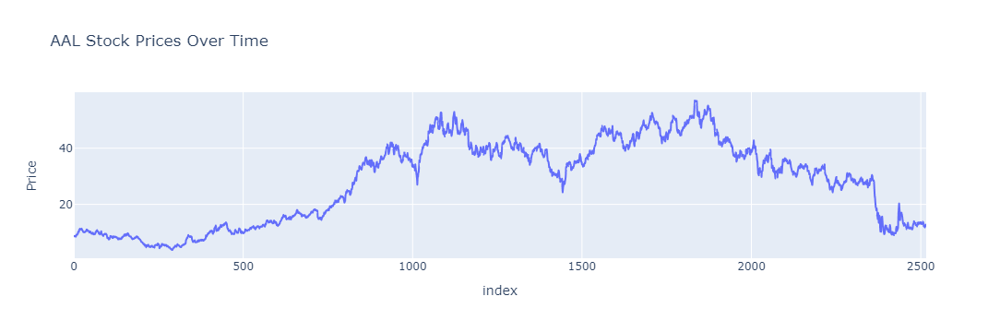

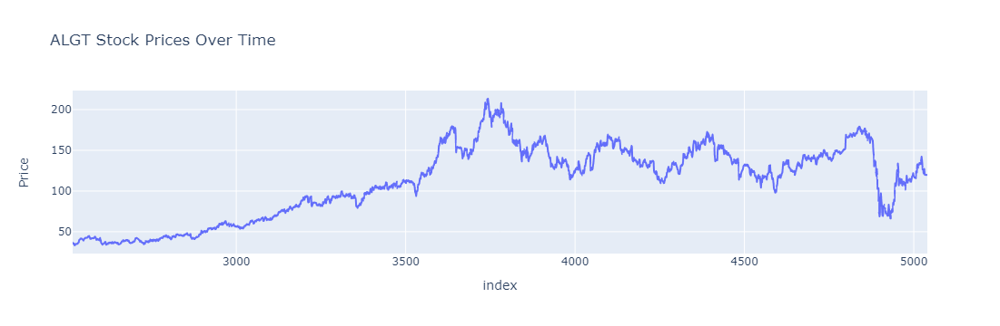

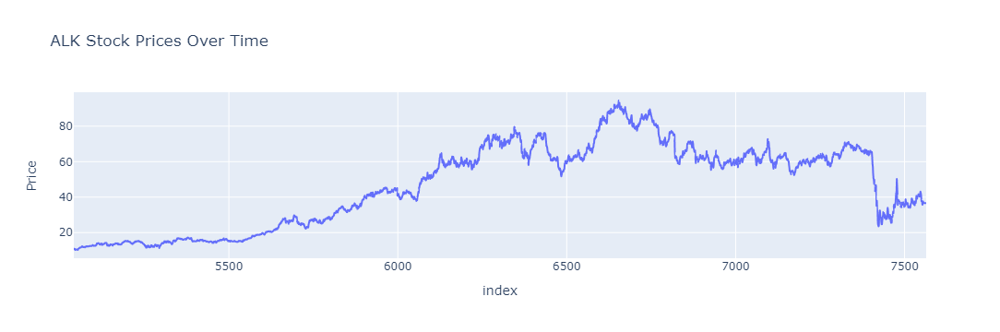

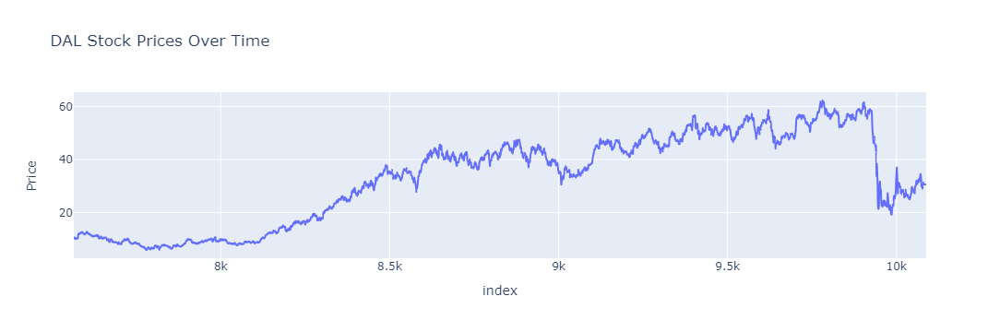

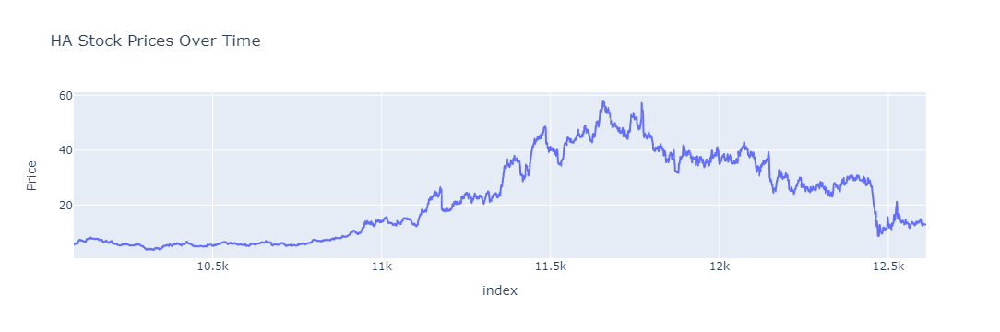

...

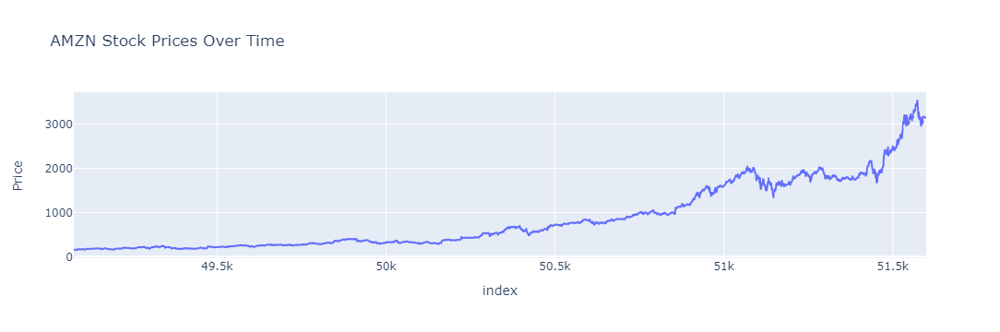

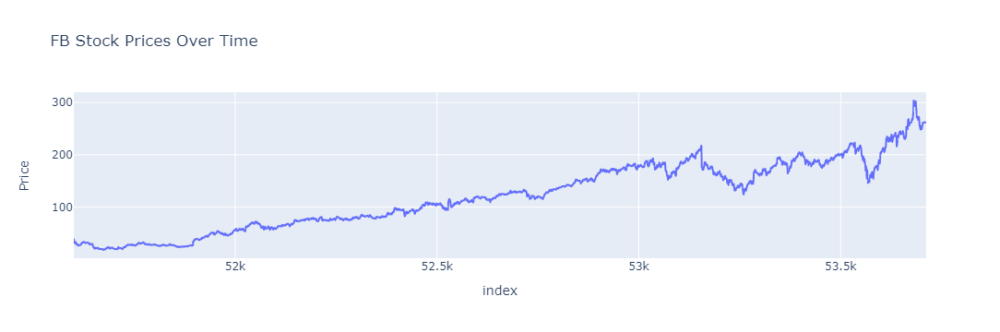

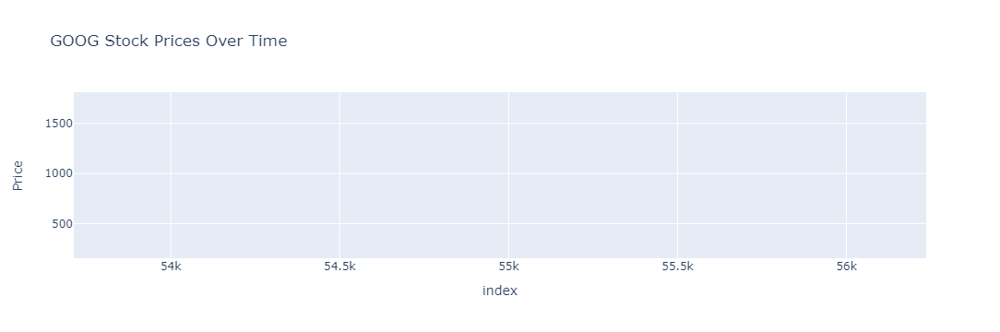

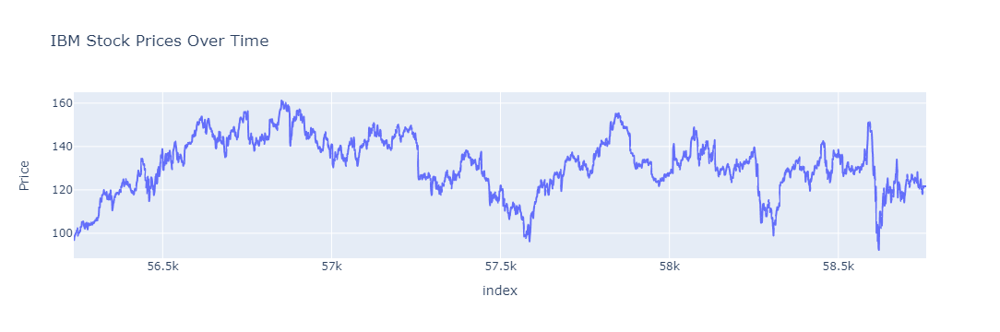

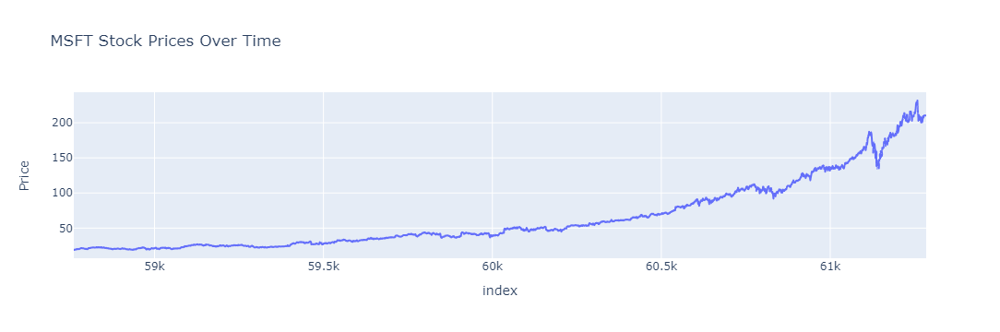

In [17]:
# Function to plot stock prices over time
def plot_stock_prices(stock_name):
    stock_data = combined_df[combined_df['Company'] == stock_name]
    fig = px.line(stock_data, x=stock_data.index, y='Adj Close', 
                  title=f'{stock_name} Stock Prices Over Time', labels={'Adj Close': 'Price'})
    fig.show()

# Loop through each stock and generate all visualizations
for stock in stock_names:
    # Plotting stock prices over time
    plot_stock_prices(stock)

### *<span style="color: red;">Trading Volume Over Time (Line Chart)</span>*: This visualization will show how the trading volume for each stock has changed over time.

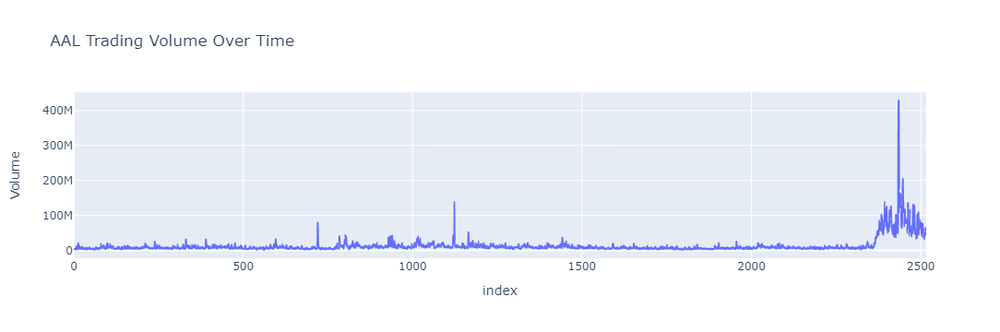

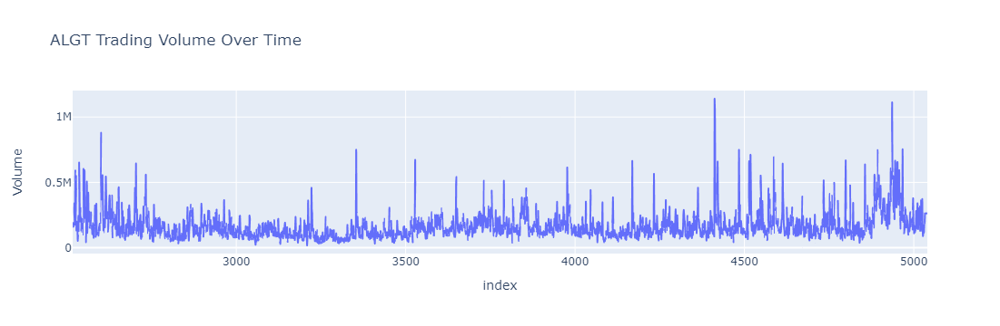

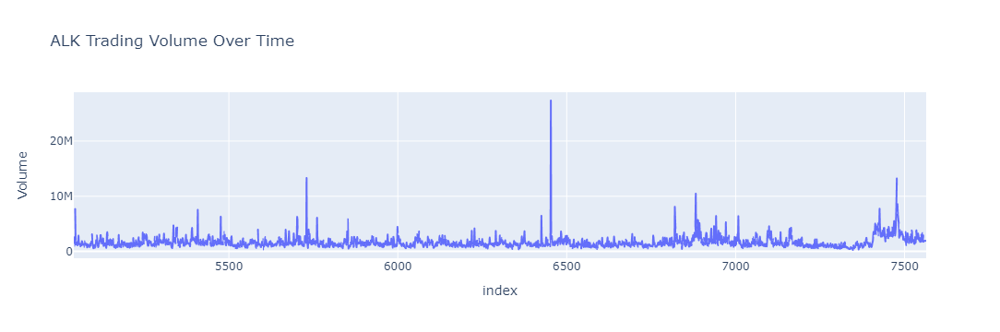

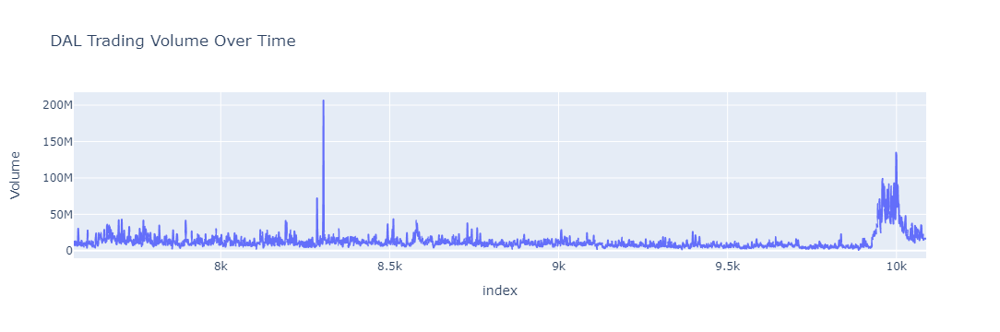

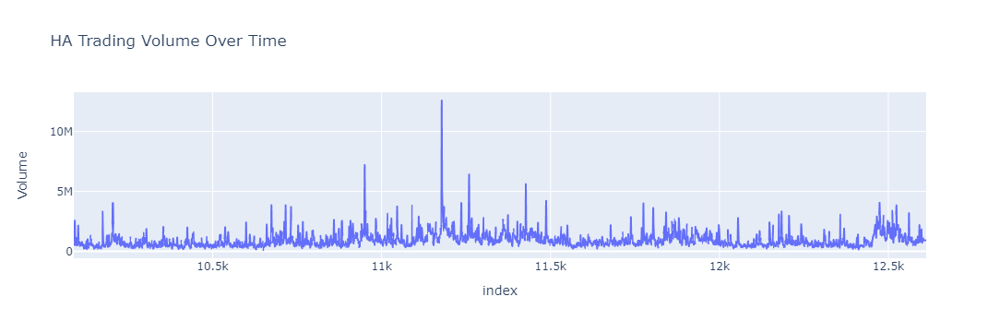

...

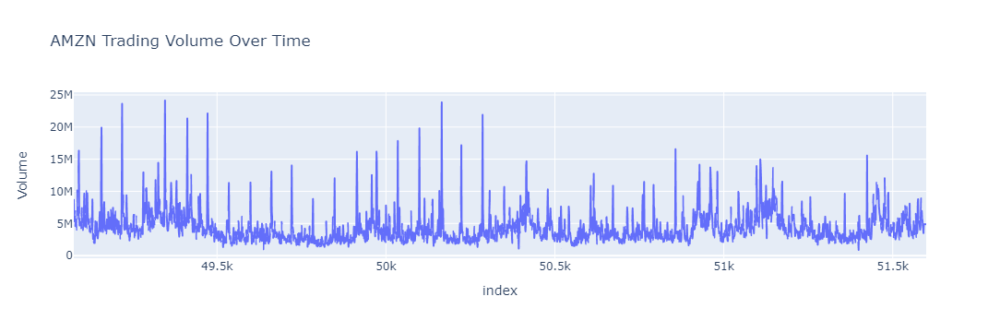

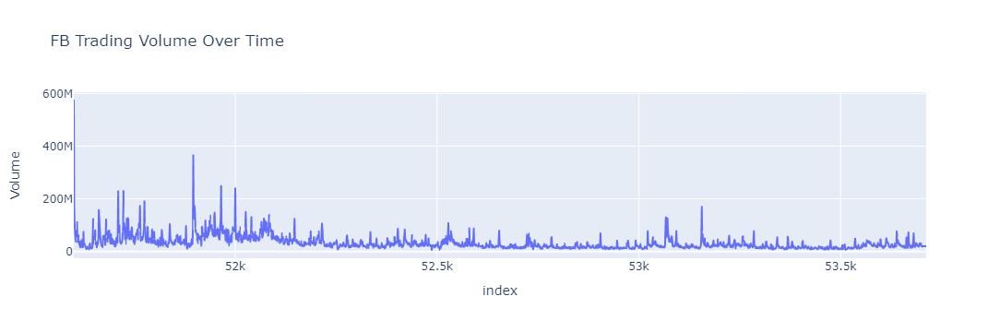

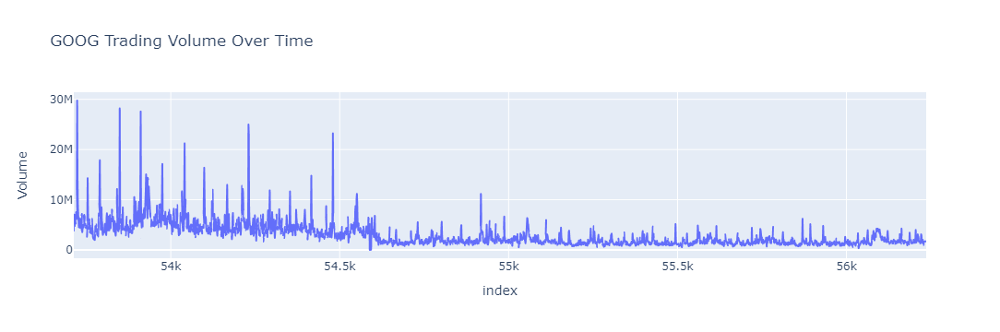

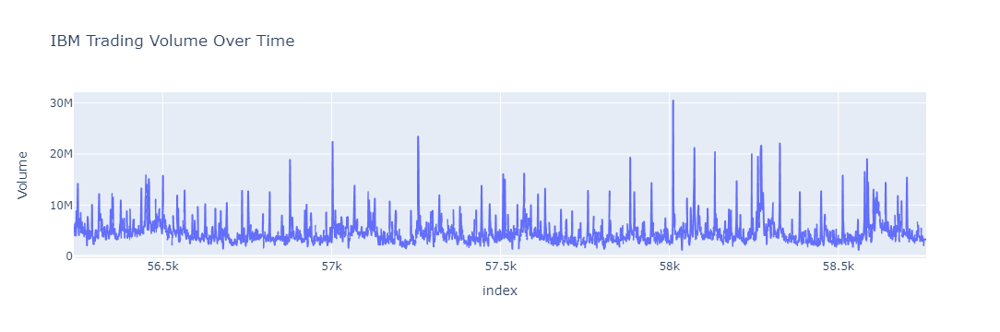

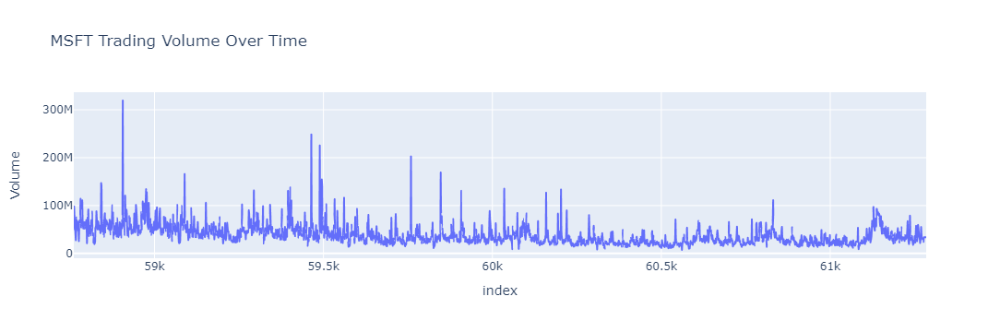

In [18]:
# Function to plot trading volume over time
def plot_trading_volume(stock_name):
    stock_data = combined_df[combined_df['Company'] == stock_name]
    fig = px.line(stock_data, x=stock_data.index, y='Volume', 
                  title=f'{stock_name} Trading Volume Over Time', labels={'Volume': 'Volume'})
    fig.show()


# Loop through each stock and generate all visualizations
for stock in stock_names:
    # Plot trading volume over time
    plot_trading_volume(stock)

### *<span style="color: red;">Stock Price vs. Trading Volume (Scatter Plot)</span>*: This scatter plot will show the relationship between the adjusted close price and the trading volume.

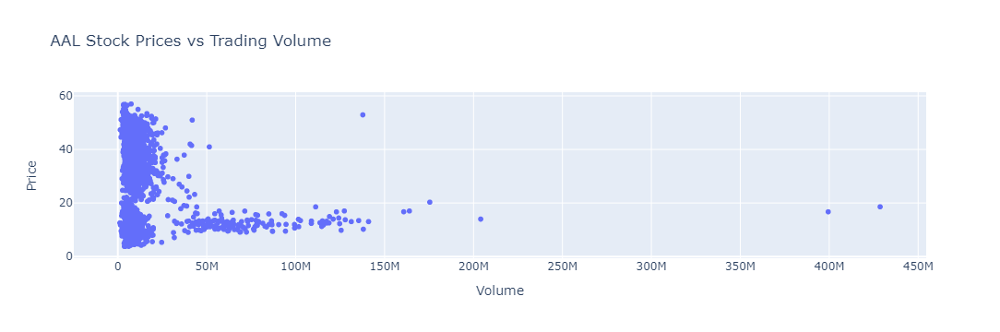

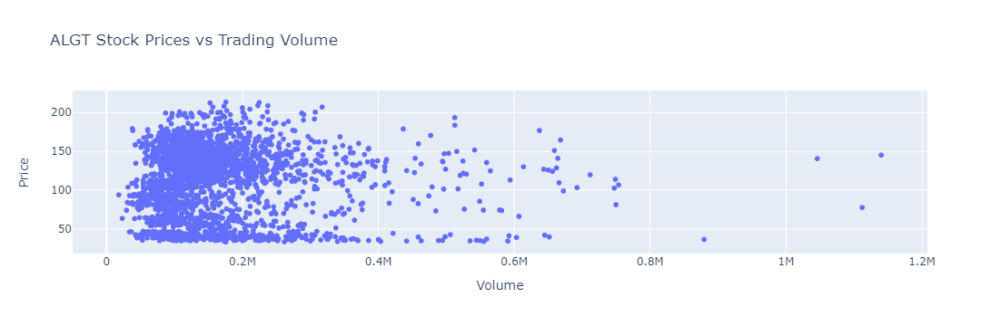

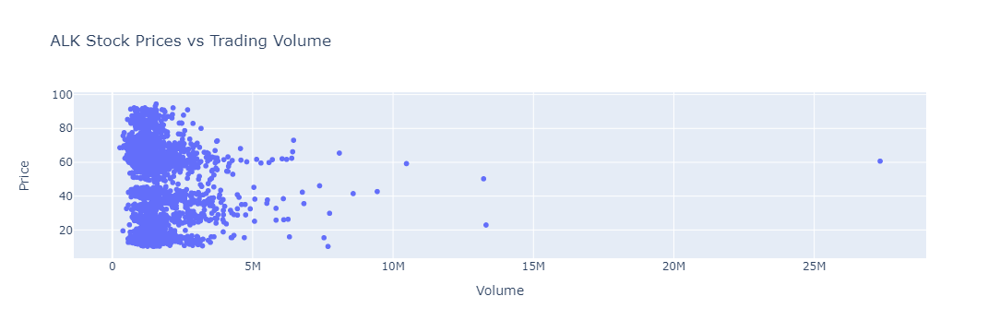

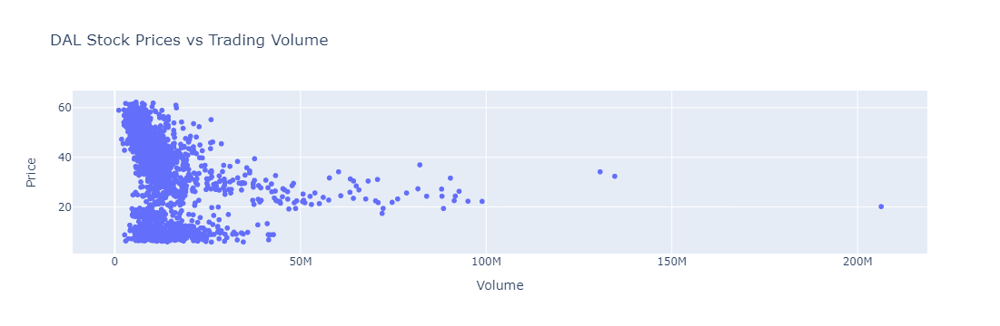

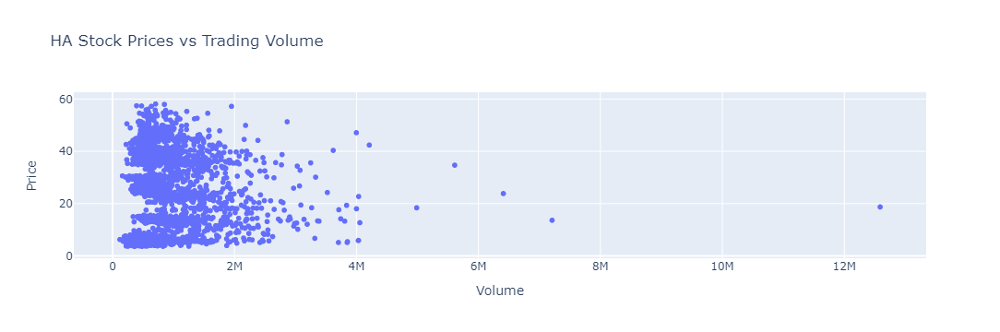

...

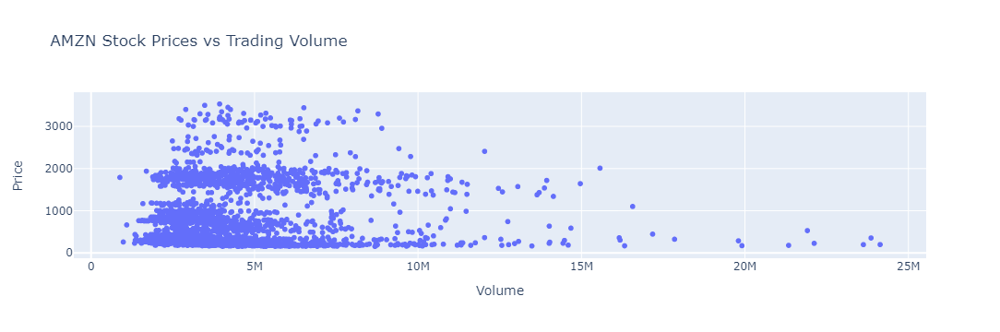

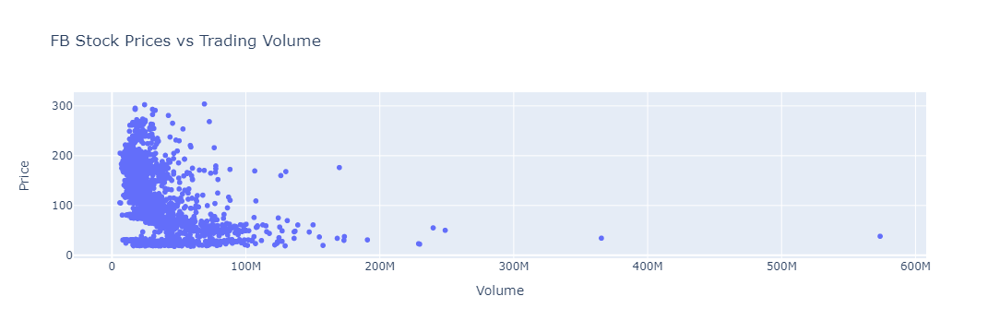

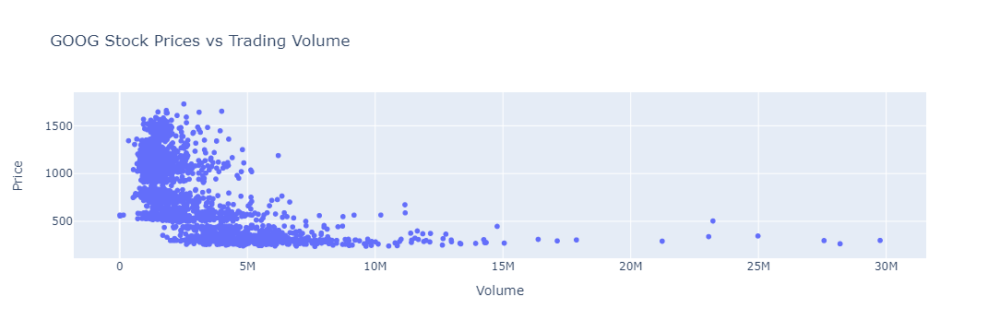

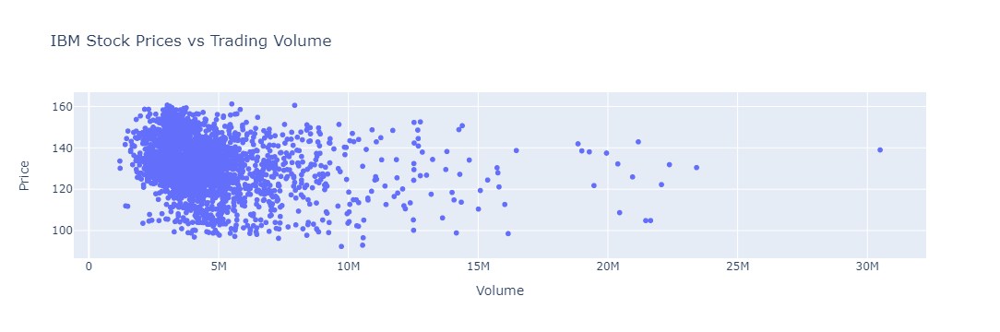

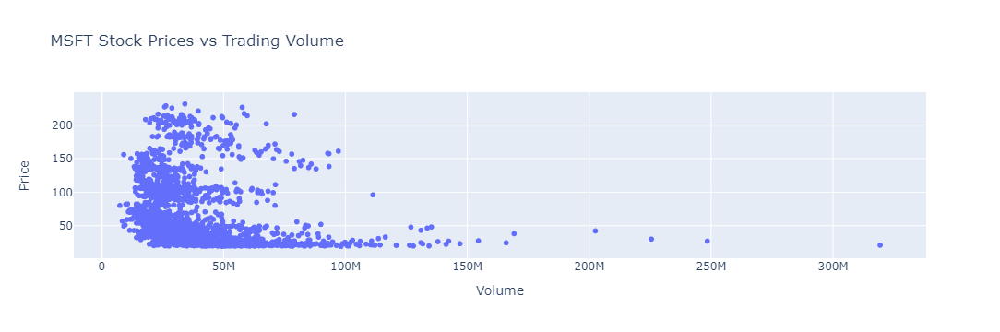

In [19]:
# Function to plot stock price vs trading volume (scatter plot)
def plot_price_vs_volume(stock_name):
    stock_data = combined_df[combined_df['Company'] == stock_name]
    fig = px.scatter(stock_data, x='Volume', y='Adj Close', 
                     title=f'{stock_name} Stock Prices vs Trading Volume', 
                     labels={'Adj Close': 'Price', 'Volume': 'Volume'})
    fig.show()

# Loop through each stock and generate all visualizations
for stock in stock_names:
    # Plot stock prices vs volume
    plot_price_vs_volume(stock)

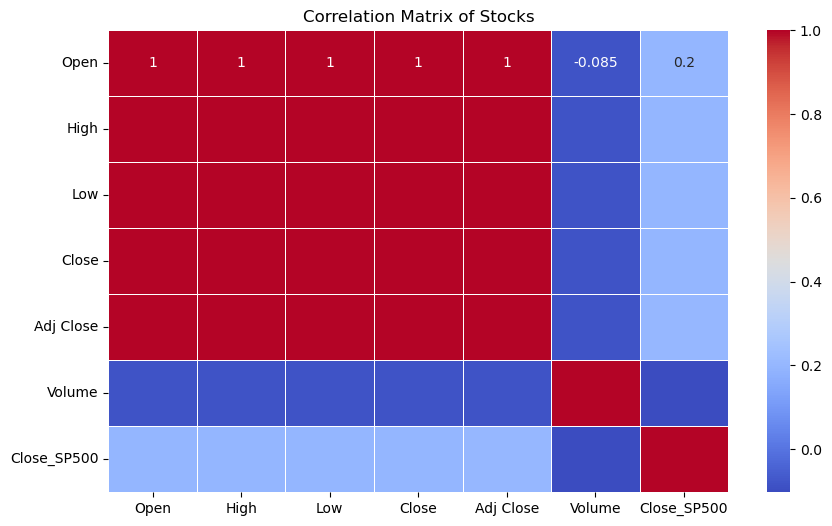

In [20]:
# Ensuring use of numerical columns only for correlation matrix
numerical_columns = combined_df.select_dtypes(include=['float64', 'int64']).columns

# Computation the correlation matrix
correlation_matrix = combined_df[numerical_columns].corr()

# Plotting the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)

# Display the heatmap
plt.title('Correlation Matrix of Stocks')
plt.show()

- Open, High, Low, Close, Adj Close, Close_SP500: all show negative correlation (-0.085) with Volume, suggesting that as the trading volume increases, the stock prices tend to slightly decrease, and vice versa. 

- Close_SP500 shows only a slight correlation (0.2) with other columns, indicating that while the stocks may move in the same direction as the broader market (S&P 500), the relationship isn’t robust.

- This also suggests that performance of individual stocks are majorly impacted by sector-specific factors, individual company performance, and global trends.

## <span style="color: green;">Trend Analysis (Time-Series Visualization)

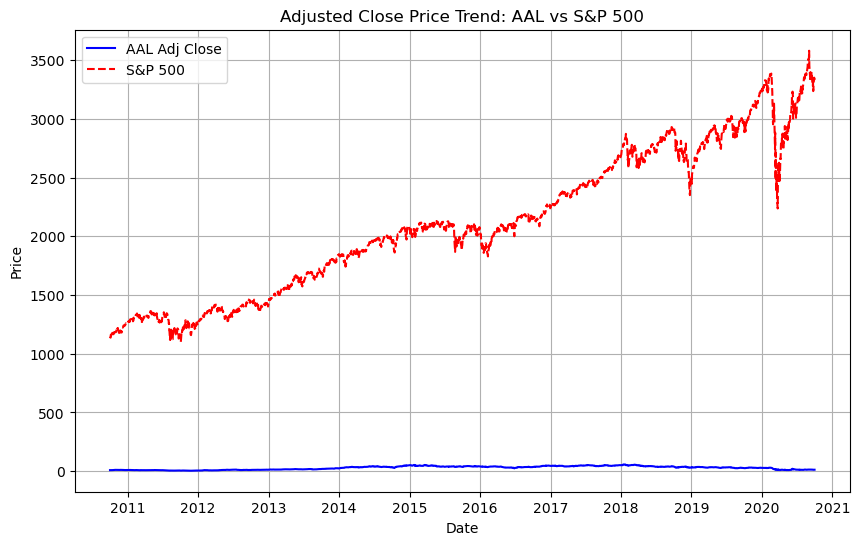

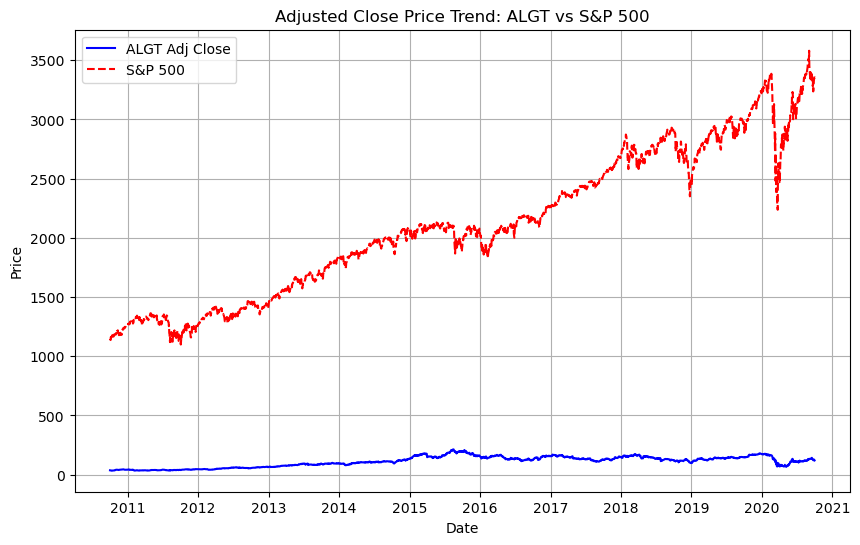

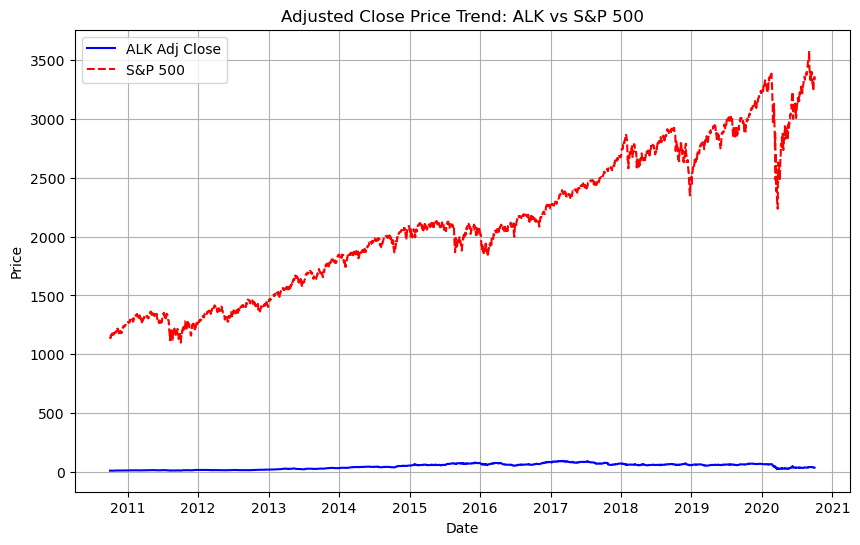

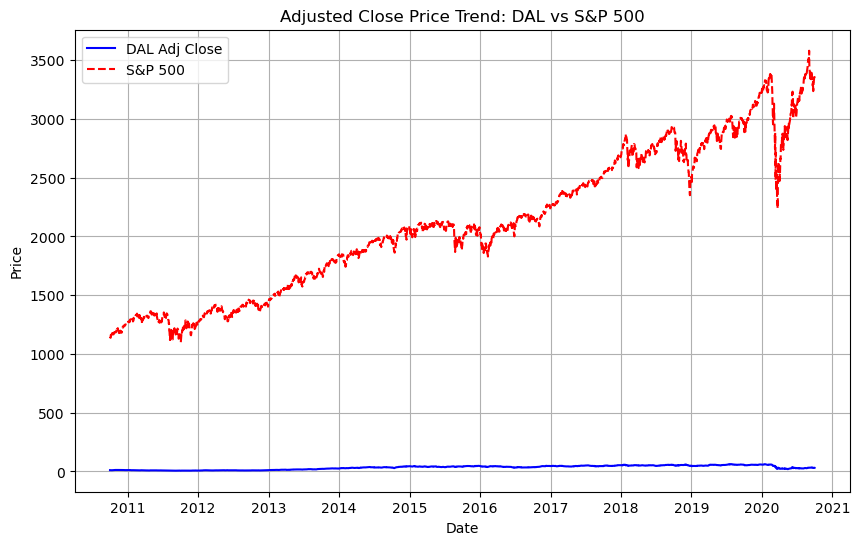

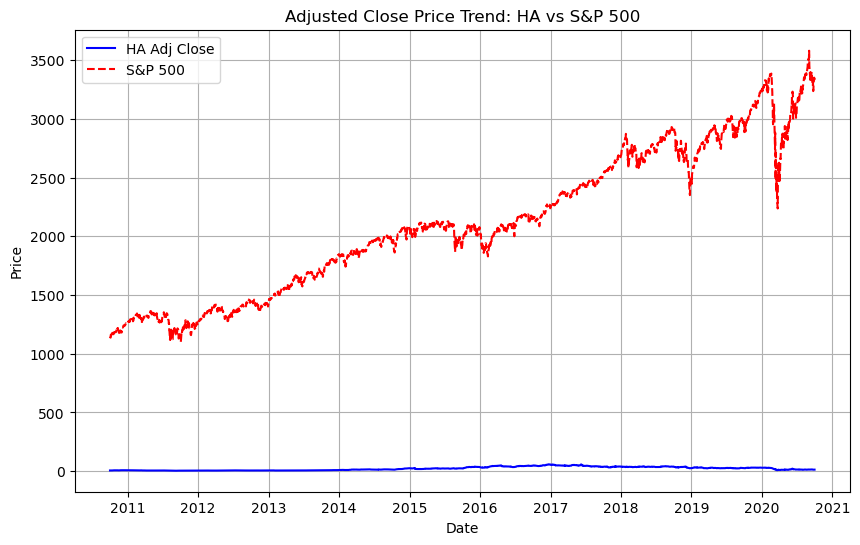

...

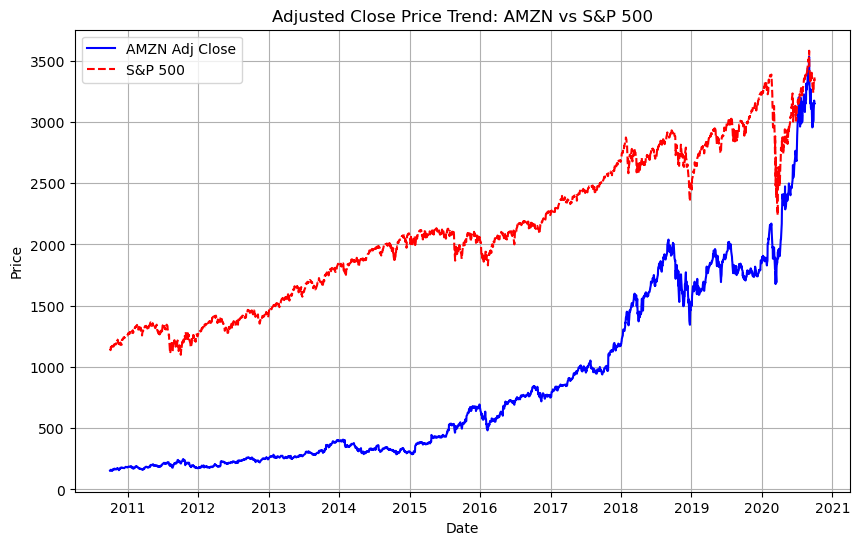

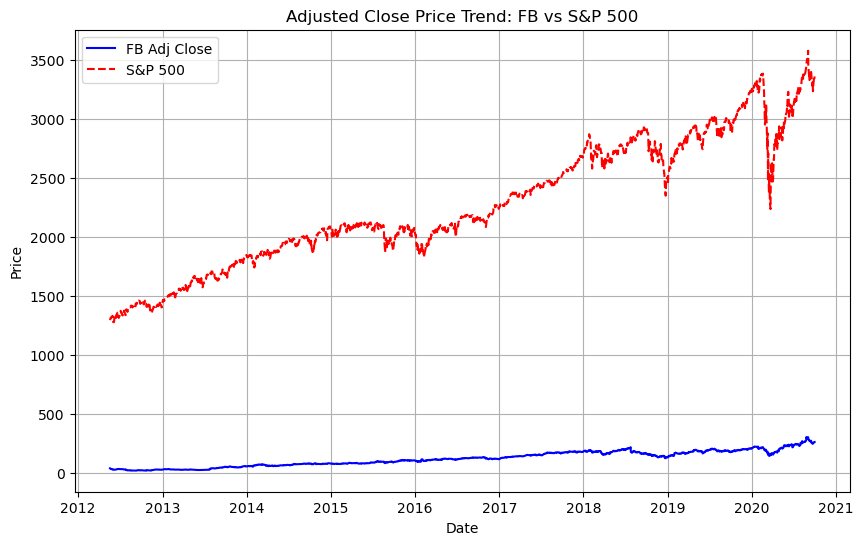

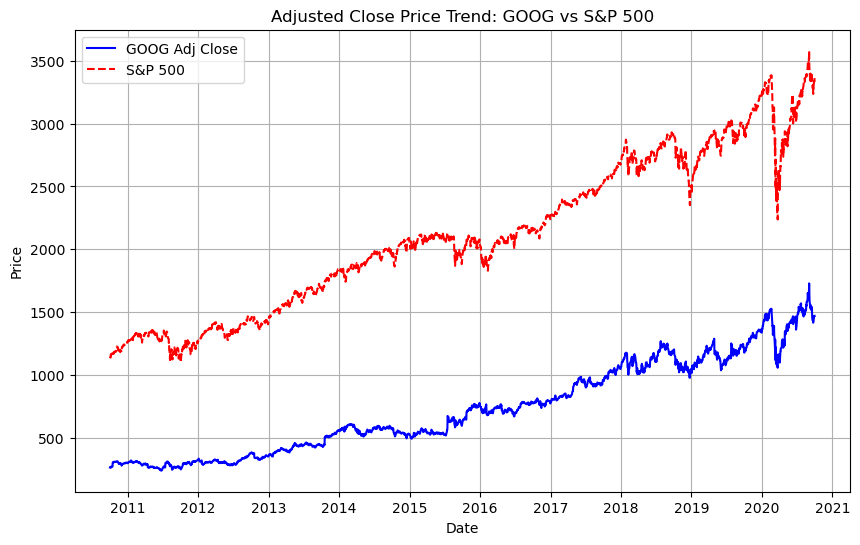

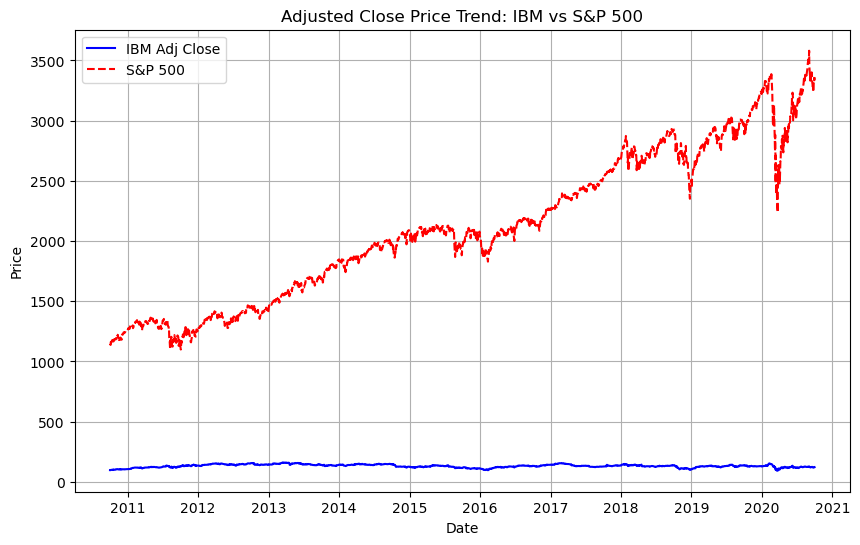

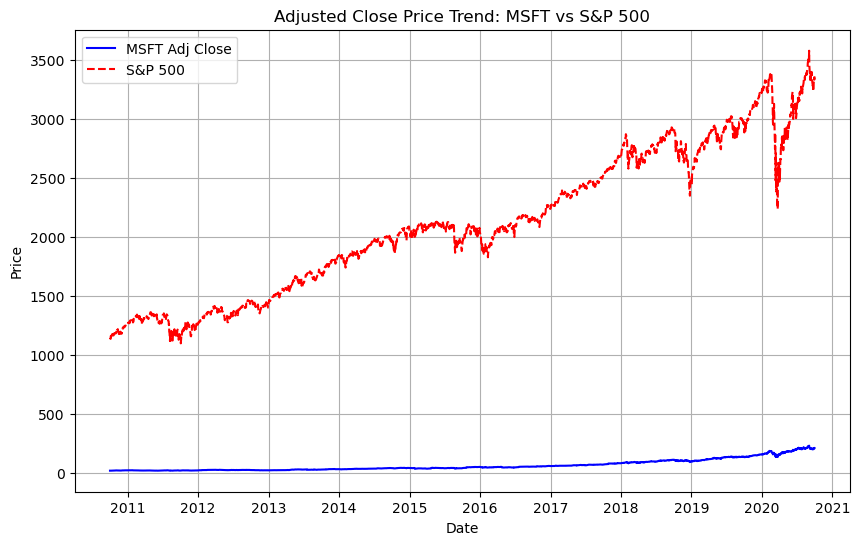

In [21]:
# Plotting the adjusted closing prices ('Adj Close') to visualize trends over time for each stock and comparing them with the S&P 500 index.

# Ensuring Date column is in datetime format with day first
combined_df['Date'] = pd.to_datetime(combined_df['Date'], dayfirst=True)

# Listing of unique companies
unique_companies = combined_df['Company'].unique()

# Plotting individual stock trends with S&P 500
for company in unique_companies:
    # Filtering data for the company
    company_data = combined_df[combined_df['Company'] == company]
    
    plt.figure(figsize=(10, 6))
    
    # Plot stock's adjusted close price
    plt.plot(company_data['Date'], company_data['Adj Close'], label=f'{company} Adj Close', color='blue')
    
    # Plot S&P 500 close price
    plt.plot(company_data['Date'], company_data['Close_SP500'], label='S&P 500', linestyle='--', color='red')
    
    plt.title(f"Adjusted Close Price Trend: {company} vs S&P 500")
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)
    plt.show()

- #### <span style="color: blue;">Amazon (AMZN)</span> and <span style="color: blue;">Alphabet (GOOG)</span> generally followed the <span style="color: red;">S&P 500</span> index's market trend, reflecting a positive correlation.

## <span style="color: green;"> Technical Analysis

### *<span style="color: green;">Moving Averages (MA)*: 
#### Calculation of Simple Moving Averages (SMA) to smooth out short-term fluctuations and understand the overall direction.

In [22]:
# Ensuring Date column is in datetime format
combined_df['Date'] = pd.to_datetime(combined_df['Date'])

# Sorting DataFrame by Date (important for accurate moving average calculation)
combined_df = combined_df.sort_values(by='Date')

In [23]:
# Calculate Simple Moving Averages
combined_df['SMA_50'] = combined_df['Adj Close'].rolling(window=50).mean()
combined_df['SMA_200'] = combined_df['Adj Close'].rolling(window=200).mean()

# Display the DataFrame with new SMA columns
combined_df.head(60)

,Date,Open,High,Low,Close,Adj Close,Volume,Company,Close_SP500,SMA_50,SMA_200
15137,2010-01-04,16.709677,16.930876,16.663595,16.894009,12.665321,2144300.0,BCS,3363.0,NaN,NaN
28697,2010-01-04,27.020000,27.480000,26.820000,27.320000,20.318752,39335700.0,WFC,3363.0,NaN,NaN
20561,2010-01-04,69.103050,70.162216,68.893127,69.875954,59.037861,469500.0,DB,3363.0,NaN,NaN
23273,2010-01-04,170.050003,174.250000,169.509995,173.080002,147.920776,9135000.0,GS,3363.0,NaN,NaN
17849,2010-01-04,49.902344,51.035156,49.765625,50.771484,34.852165,734200.0,CS,3363.0,NaN,NaN
25985,2010-01-04,30.700001,31.969999,30.629999,30.910000,25.759523,20371000.0,MS,3363.0,NaN,NaN
25986,2010-01-05,31.010000,32.130001,30.930000,32.040001,26.701244,22523400.0,MS,3363.0,NaN,NaN
15138,2010-01-05,17.631336,17.852535,17.520737,17.824884,13.363193,2710600.0,BCS,3363.0,NaN,NaN
20562,2010-01-05,71.412216,71.698471,70.610687,71.211830,60.166534,503300.0,DB,3363.0,NaN,NaN
23274,2010-01-05,173.000000,176.259995,172.570007,176.139999,150.535919,11659400.0,GS,3363.0,NaN,NaN


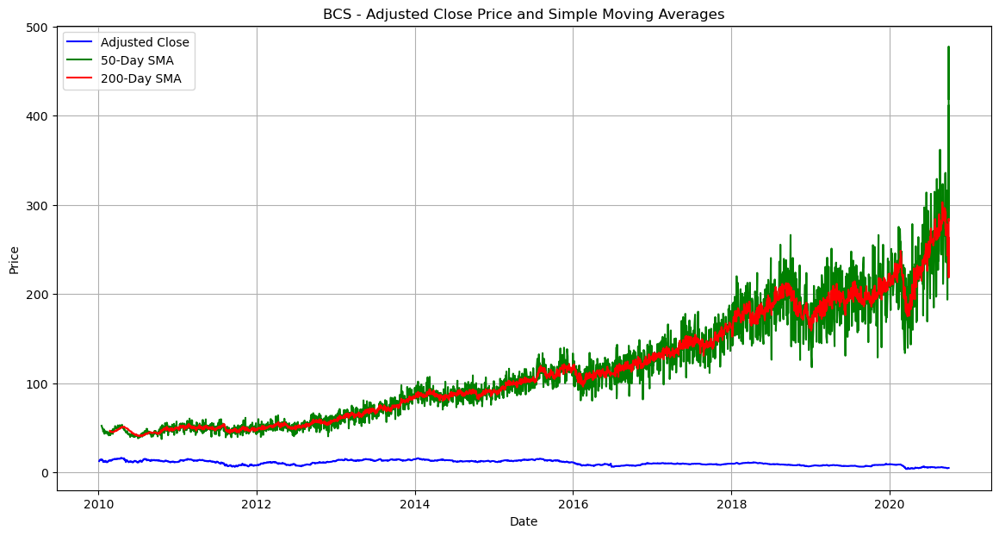

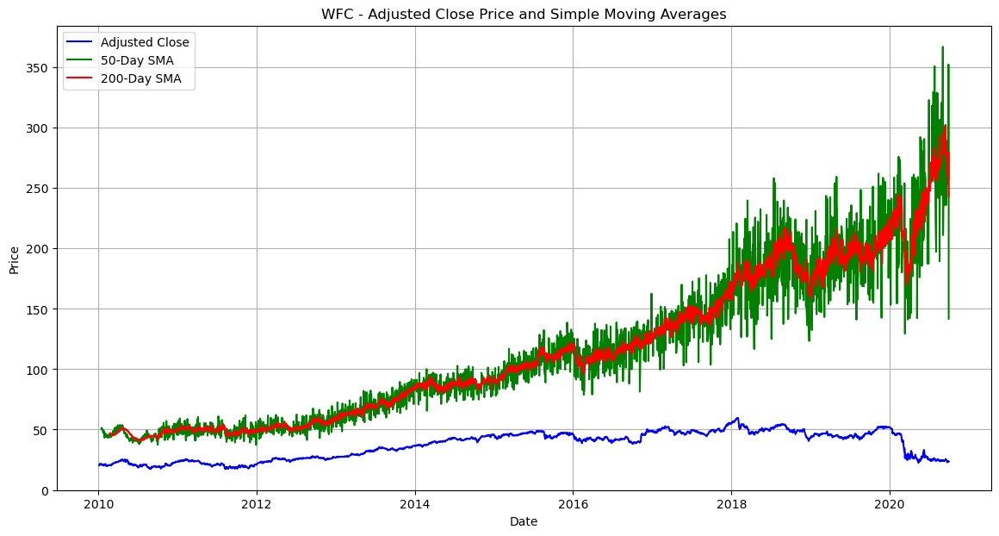

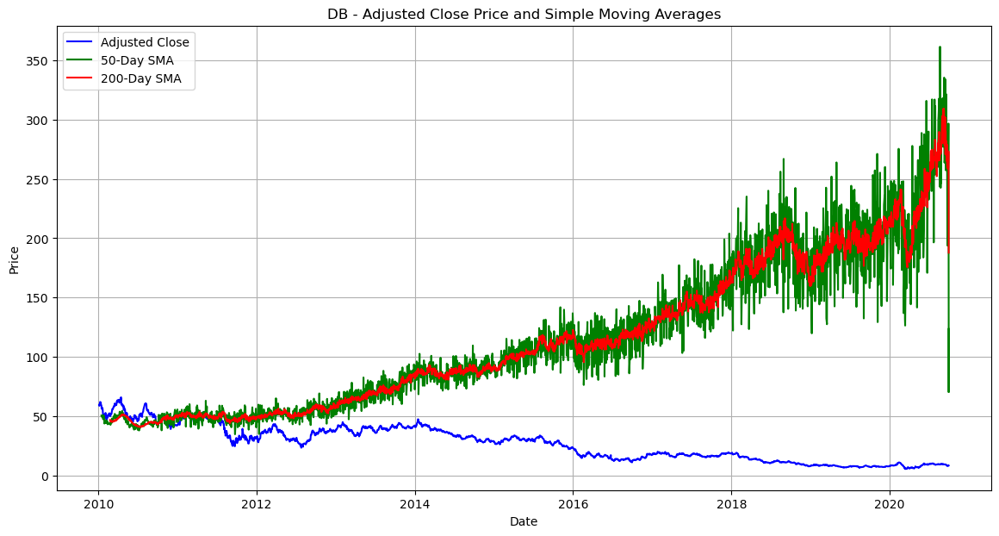

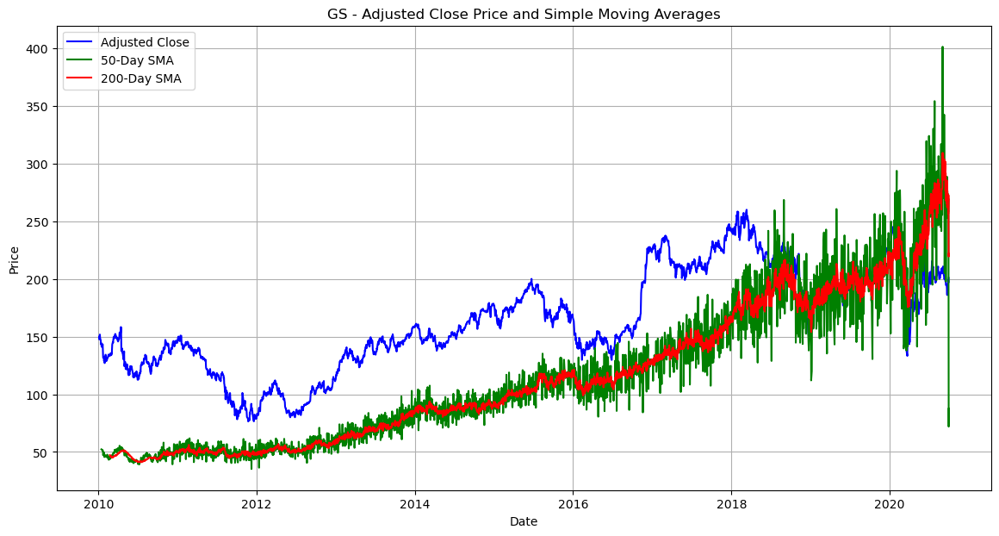

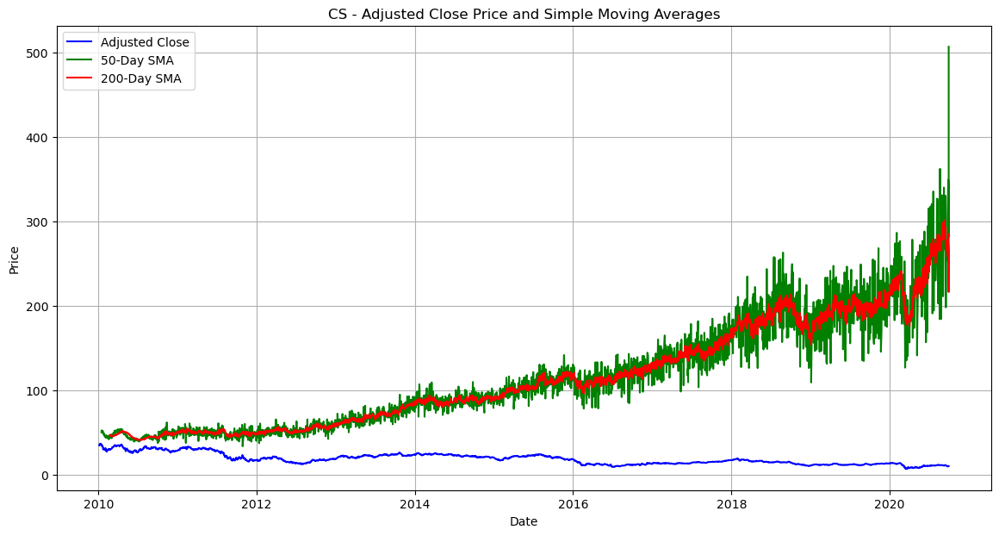

...

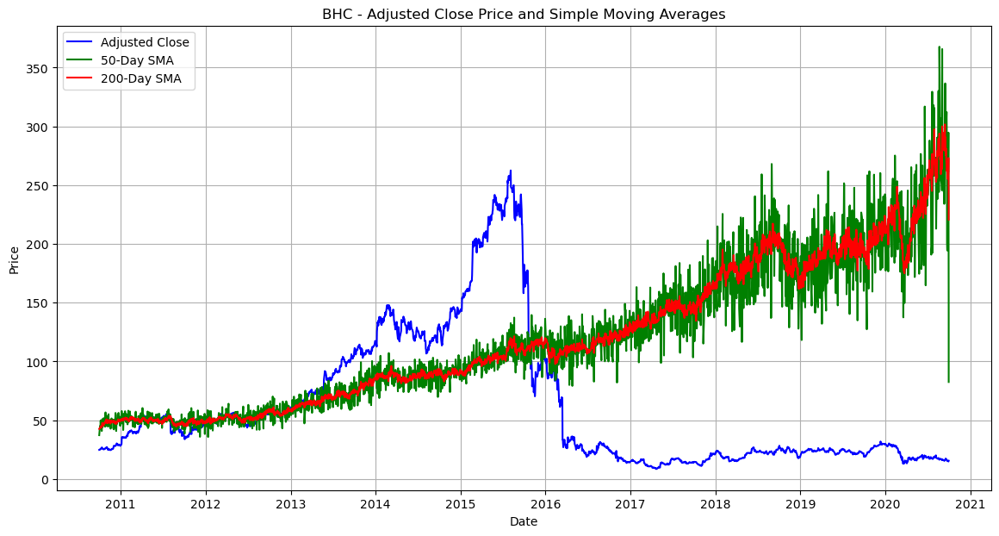

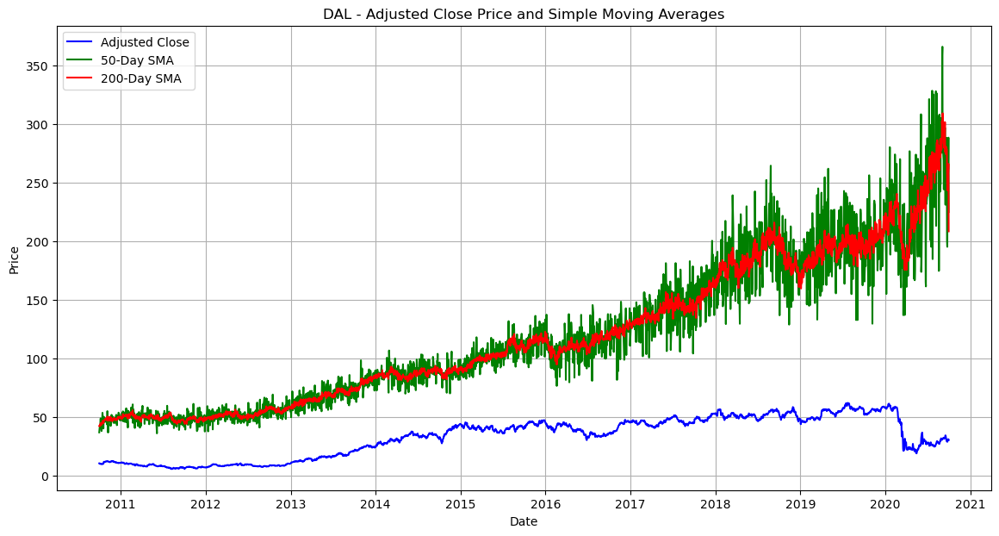

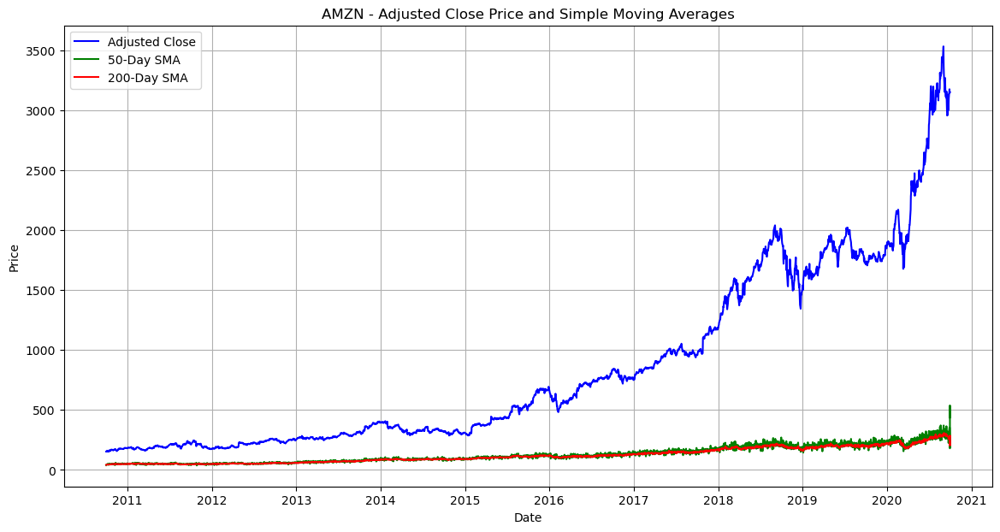

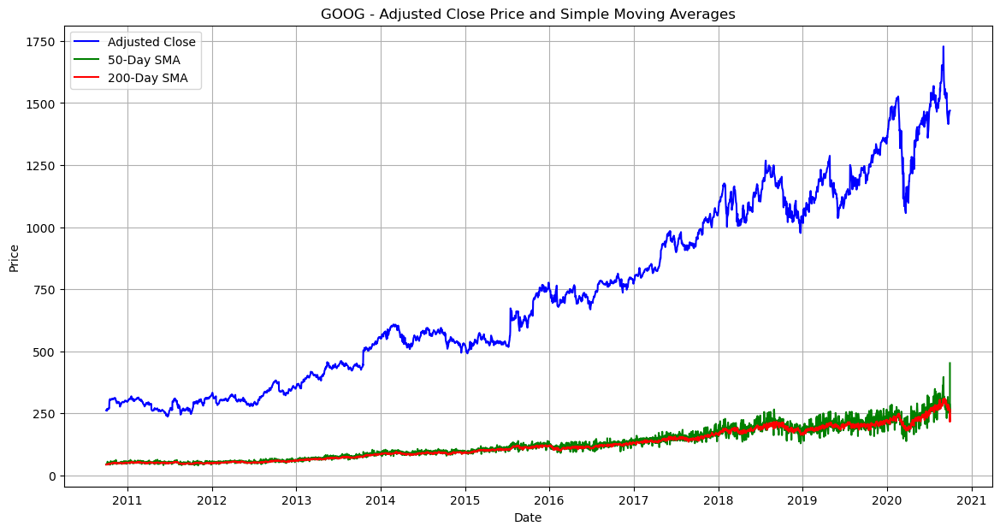

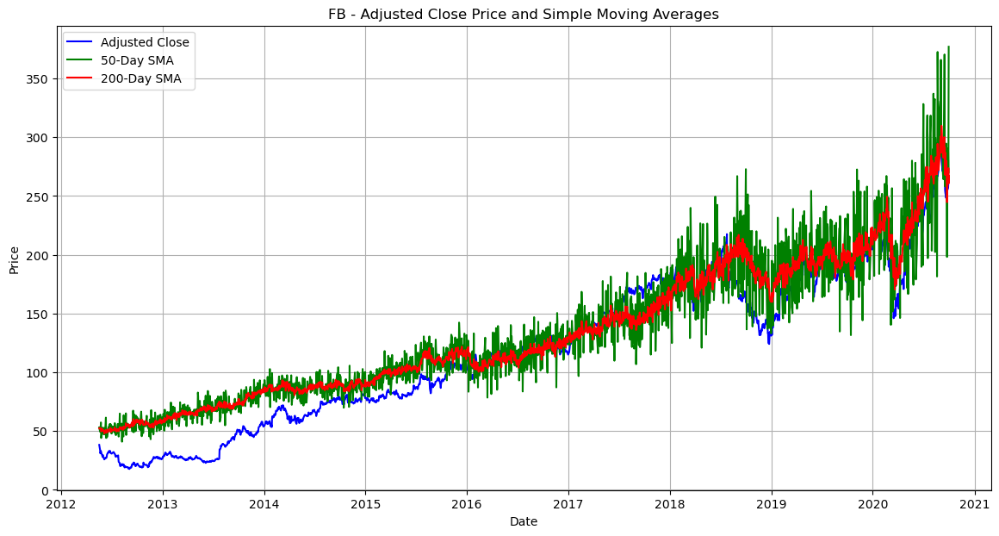

In [24]:
import matplotlib.pyplot as plt

# Ensuring the 'Date' column is in datetime format
combined_df['Date'] = pd.to_datetime(combined_df['Date'], format='%Y-%m-%d')

# Getting the list of unique companies
companies = combined_df['Company'].unique()

# Plotting for each company
for company in companies:
    # Filtering data for the current company
    company_data = combined_df[combined_df['Company'] == company]

    # Creating a plot
    plt.figure(figsize=(14, 7))

    # Plotting adjusted close prices
    plt.plot(company_data['Date'], company_data['Adj Close'], label='Adjusted Close', color='blue')

    # Plotting 50-day SMA if available
    if 'SMA_50' in company_data.columns:
        plt.plot(company_data['Date'], company_data['SMA_50'], label='50-Day SMA', color='green')

    # Plotting 200-day SMA if available
    if 'SMA_200' in company_data.columns:
        plt.plot(company_data['Date'], company_data['SMA_200'], label='200-Day SMA', color='red')

    # Add titles and labels
    plt.title(f'{company} - Adjusted Close Price and Simple Moving Averages')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)
    
    # Show plot
    plt.show()

#### <span style="color: red;">Finance</span>

#### 1. <span style="color: blue;">DB (Deutsche Bank)</span>

- Crossover (2010-2012): When the stock price crosses its moving averages, it often signals a change in trend direction.

- Post-2012 Downward Trend: The stock price declined while the moving averages might have remained more stable, indicating a period of underperformance relative to historical averages.

#### 2. <span style="color: blue;">GS (Goldman Sachs)</span>

- Upward Trend: The stock's price increased over time, which is a positive signal for investors.

- Post-2018 Alignment: When the stock price and moving averages align, it indicates that the moving averages accurately reflect the stock's trend, showing stability and consistency.

#### <span style="color: red;">Healthcare</span> 

#### 1. <span style="color: blue;">JNJ (Johnson & Johnson)</span>

- Pre-2015 Alignment: Early stability where stock price and simple moving averages followed similar trends.

- Post-2015 Pattern: While they continued to follow similar patterns, the stock price diverged after 2018, indicating a deviation from the general trend which could signify a period of volatility or underperformance.

#### 2. <span style="color: blue;">BHC (Bausch Health Companies)</span>

- 2011 to Mid-2013 Alignment and Crossover: Shows initial stability and then a trend change.

- Mid-2013 to 2016 Upward Trend: A period of growth where the stock price increased relative to simple moving averages.

- Post-2016 Downward Trend: After an initial improvement, the stock price began to decline, indicating possible issues or a market shift.

#### 3. <span style="color: blue;">UNH (UnitedHealth Group)</span>

- Consistent Alignment: The stock price and moving averages moving together suggest a stable performance where the stock's trend matches the average market trends.

#### <span style="color: red;">Aviation</span>

#### <span style="color: blue;">ALGT (Allegiant Travel)</span>

- Pre-2015 Alignment: Early stability with aligned trends.

- 2014-End to Mid-2016: Outperformance during this period, where the stock price rose faster than the moving averages.

- Mid-2016 to Early 2018: All three metrics (adjusted close, SMA 50, SMA 200) were aligned.

- Post-2018 Downward Trend: The stock price decreased after 2018, diverging from the moving averages, signaling potential underperformance or market challenges.

#### <span style="color: red;">Technology</span>

#### 1. <span style="color: blue;">IBM (International Business Machines)</span>

- Mid-2015 to 2018 Crossover: Indicates changes in trend direction.

- Post-2018 Downward Trend: A decline in stock price after a crossover suggests potential issues or a bearish market phase for IBM.

#### 2. <span style="color: blue;">MSFT (Microsoft)</span>

- Upward Trend: Positive performance with the stock price rising consistently.

- Post-Mid-2019 Consistency: Continued alignment with simple moving averages indicates that the stock's strong performance was sustainable and in line with general market trends.

#### 3. <span style="color: blue;">AMZN (Amazon)</span>

- Upward Trajectory: The stock price has consistently performed well compared to moving averages, indicating strong growth and market dominance.

#### 4. <span style="color: blue;">GOOGL (Alphabet)</span>

- Upward Trend: Similar to AMZN, the consistent upward performance relative to moving averages reflects strong and steady growth.

#### 5. <span style="color: blue;">FB (Facebook ; Meta Platforms)</span>

- Consistent Alignment: Reflects stability where the stock's price and simple moving averages followed the same trend, indicating reliable performance.

#### <span style="color: red;">Other Stocks</span>

- Remaining Stocks have underperformed where adjusted close ('Adj Close') prices followed downward path compared to SMA50 and SMA200.

### *<span style="color: green;">Relative Strength Index (RSI)*:
#### RSI helps determine whether a stock is overbought or oversold. It’s a momentum oscillator that ranges from 0 to 100.

In [25]:
# Function to calculate RSI
def calculate_rsi(df, period=14):
    delta = df['Adj Close'].diff()
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)
    
    avg_gain = gain.rolling(window=period, min_periods=1).mean()
    avg_loss = loss.rolling(window=period, min_periods=1).mean()
    
    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    
    return rsi.round(2)

# Calculation of RSI for each stock and get the latest RSI value
def get_latest_rsi(df):
    df = df.copy()  # Create a copy to avoid modifying the original DataFrame
    df['RSI'] = calculate_rsi(df)
    
    # Ensuring that RSI is calculated and check column names
    print("Columns in DataFrame:", df.columns)
    
    # Extracting the latest RSI value for each stock
    latest_rsi = df.groupby('Company').apply(lambda x: x.iloc[-1][['RSI']]).reset_index()
    return latest_rsi

# Calculation RSI and get latest RSI values
latest_rsi_df = get_latest_rsi(combined_df)

# Verifying the contents of latest_rsi_df
print("Latest RSI DataFrame:")
print(latest_rsi_df.head())

# Identifying oversold and overbought stocks
oversold_stocks = latest_rsi_df[latest_rsi_df['RSI'] < 30]
overbought_stocks = latest_rsi_df[latest_rsi_df['RSI'] > 70]

# Printing results
print("\nMost Oversold Stocks:")
print(oversold_stocks)

print("\nMost Overbought Stocks:")
print(overbought_stocks)

Columns in DataFrame: Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'Company', 'Close_SP500', 'SMA_50', 'SMA_200', 'RSI'],
      dtype='object')
Latest RSI DataFrame:
  Company     RSI
0     AAL    1.27
1    AAPL   59.21
2    ALGT   34.93
3     ALK   33.82
4    AMZN  100.00

Most Oversold Stocks:
   Company   RSI
0      AAL  1.27
9       DB  0.00
15     JNJ  0.00
17     MRK  0.00

Most Overbought Stocks:
   Company     RSI
4     AMZN  100.00
10      FB  100.00
16     LUV   86.76
20     PFE   74.06
22     UNH  100.00


#### As per RSI values:

#### Most Oversold Stocks:

- <span style="color: red;">AAPL (Apple Inc)</span>
- <span style="color: red;">LUV (Southwest Airlines Co)</span>
- <span style="color: red;">PFE (Pfizer inc)</span>
- <span style="color: red;">RHHBY (Roche Holding AG)</span>

#### Most Overbought Stocks:

- <span style="color: blue;">AMZN (Amazon)</span>
- <span style="color: blue;">FB (Facebook / Meta platforms)</span>
- <span style="color: blue;">GOOG (Google)</span>
- <span style="color: blue;">MSFT (Microsoft)</span>

### *<span style="color: green;">Bollinger Bands*:
#### Bollinger Bands plot a range that the stock price is expected to trade within, based on its recent volatility.

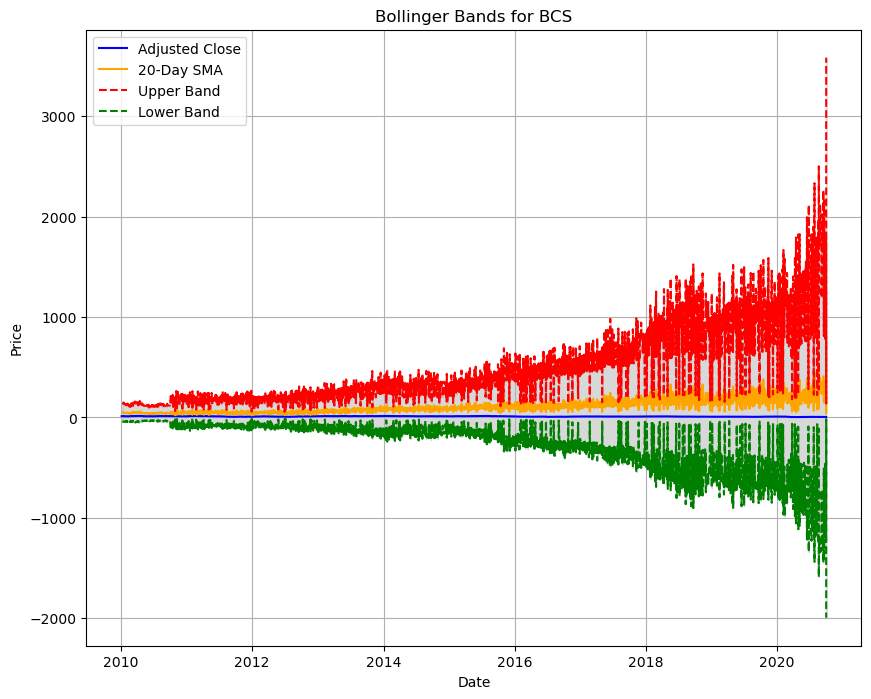

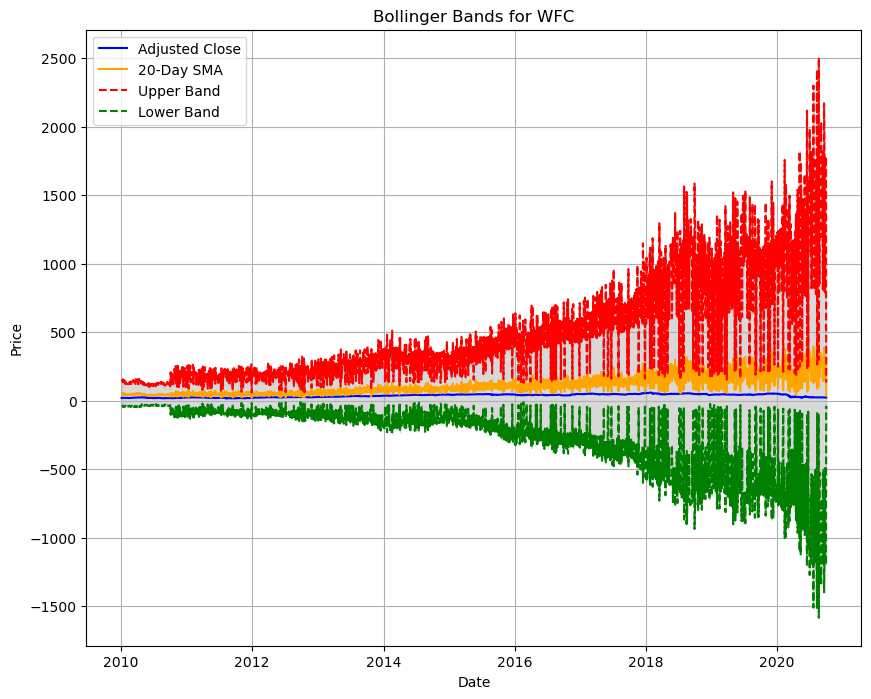

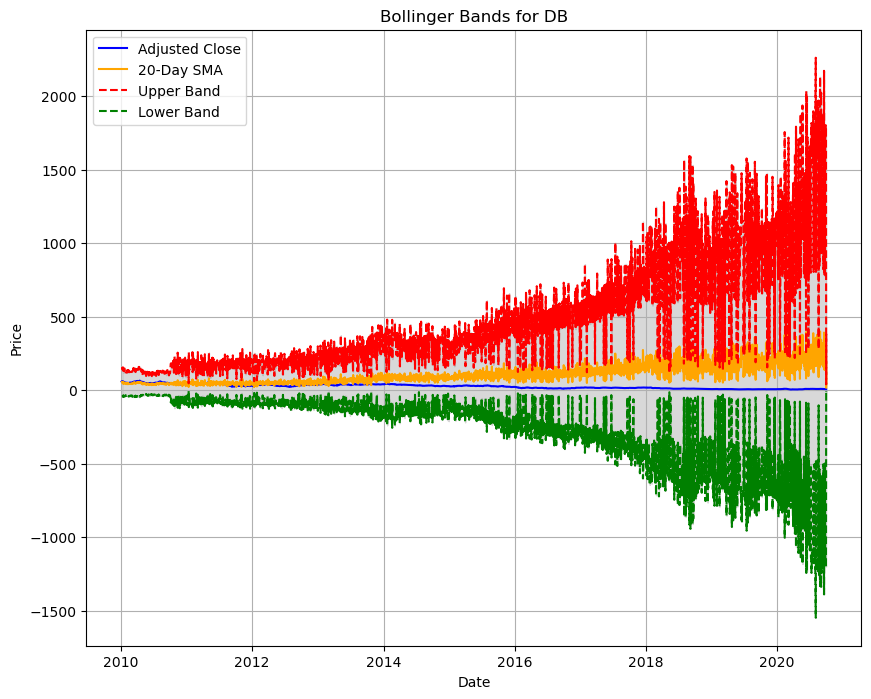

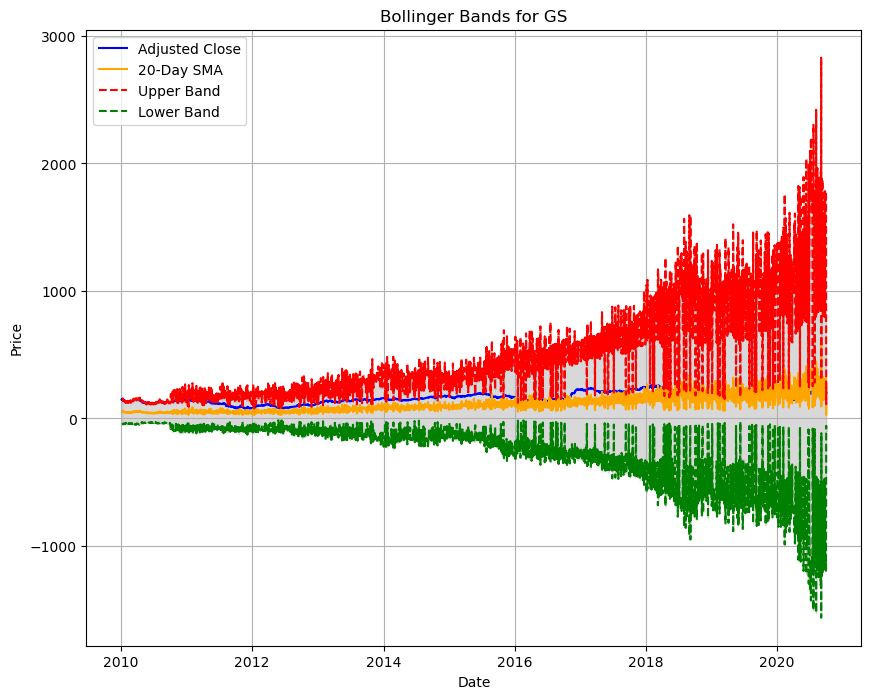

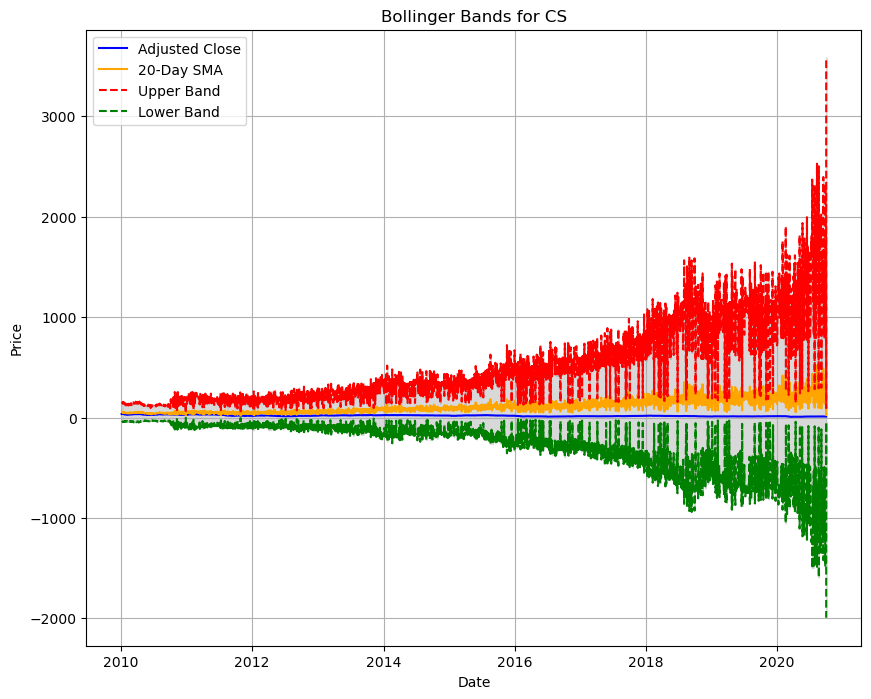

...

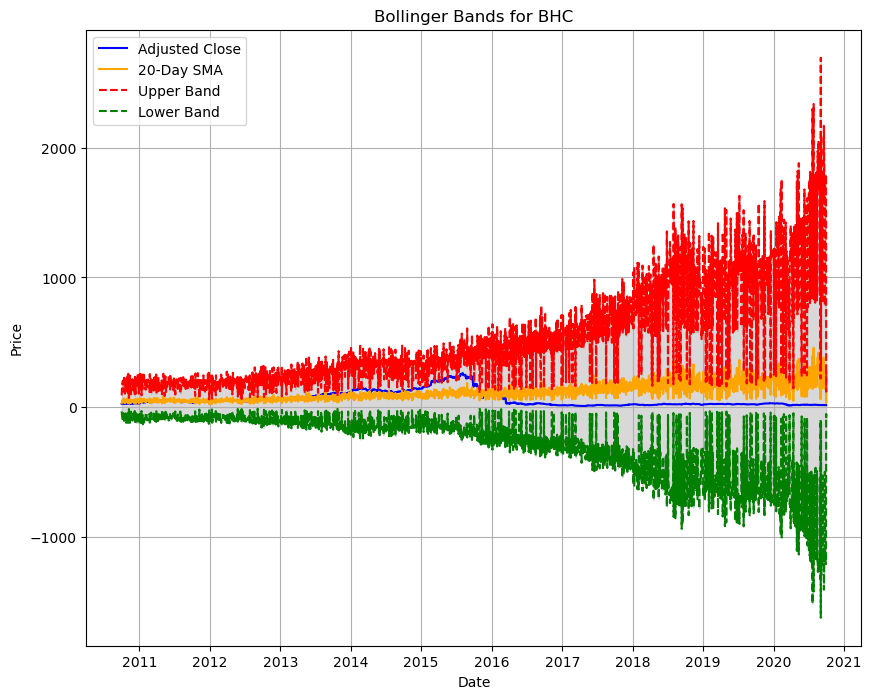

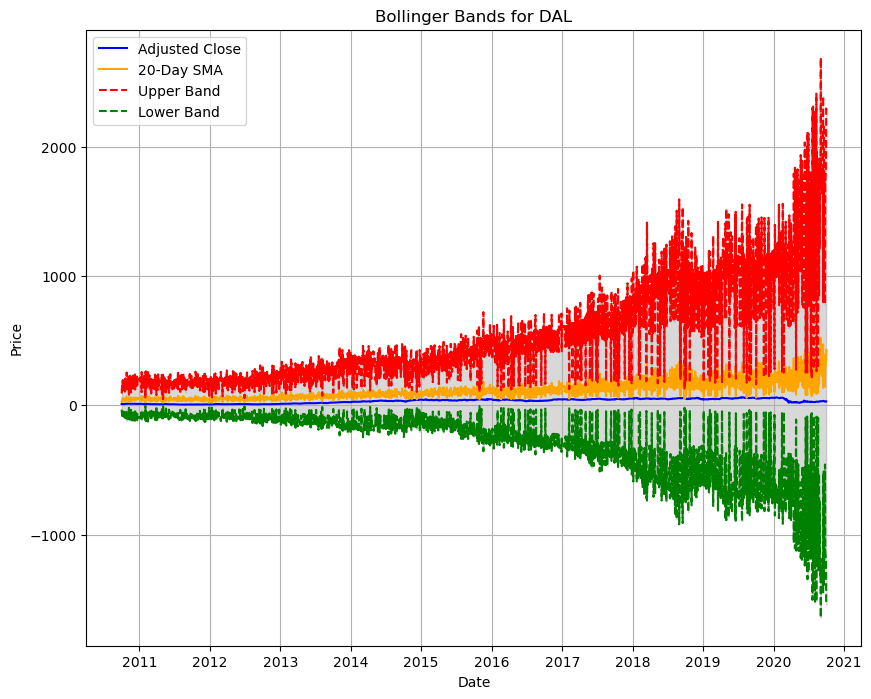

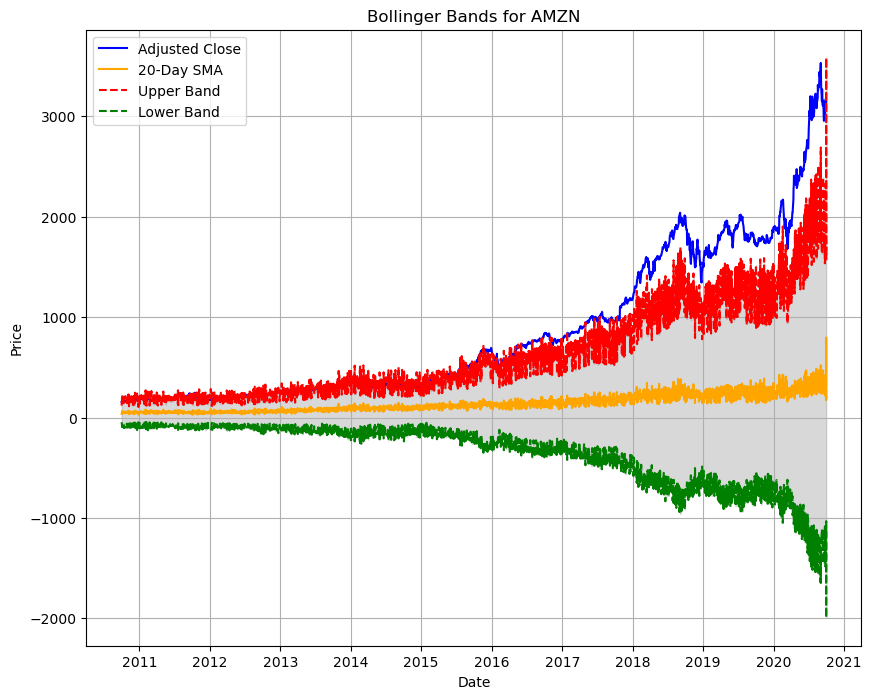

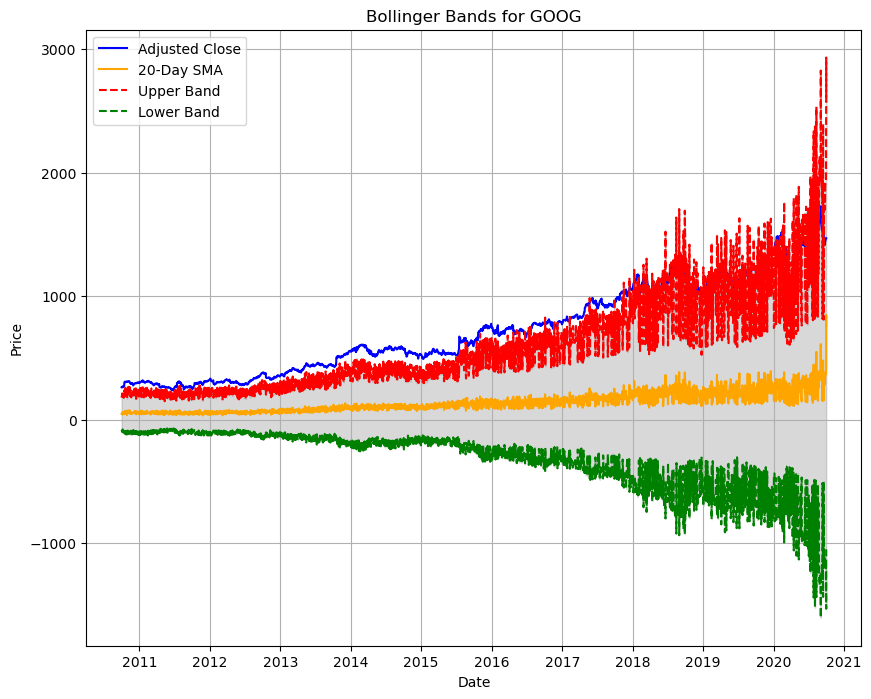

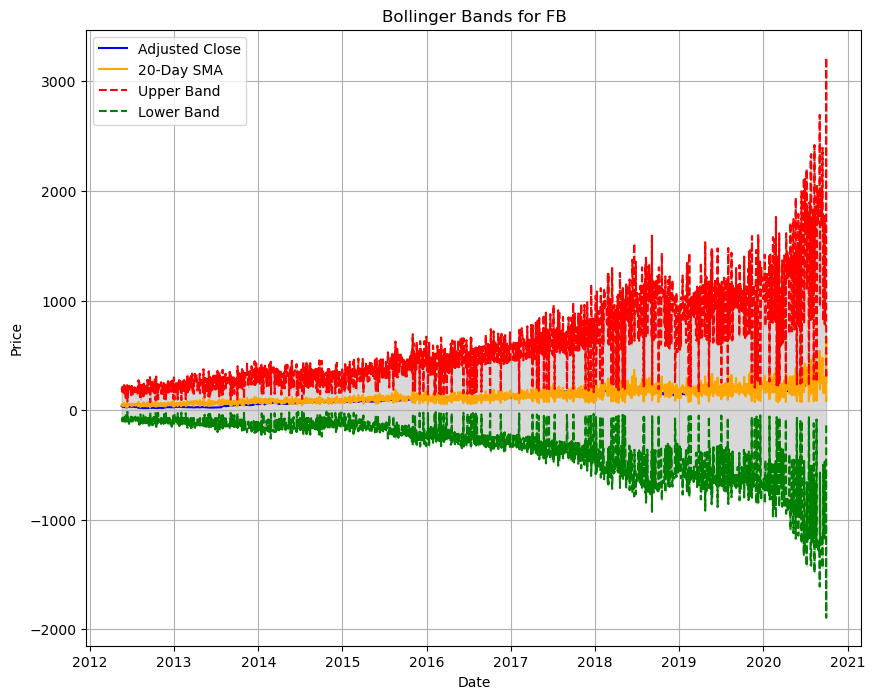

In [26]:
import pandas as pd
import matplotlib.pyplot as plt

# Defining a function to plot Bollinger Bands
def plot_bollinger_bands(stock_data, company_name):
    # Ensure that the 'Date' column is in datetime format
    stock_data['Date'] = pd.to_datetime(stock_data['Date'])

    plt.figure(figsize=(10, 8))

    # Plotting the adjusted close price
    plt.plot(stock_data['Date'], stock_data['Adj Close'], label='Adjusted Close', color='blue')

    # Plotting the 20-day SMA
    plt.plot(stock_data['Date'], stock_data['20_day_SMA'], label='20-Day SMA', color='orange')

    # Plotting the Bollinger Bands
    plt.plot(stock_data['Date'], stock_data['Upper_Band'], label='Upper Band', color='red', linestyle='--')
    plt.plot(stock_data['Date'], stock_data['Lower_Band'], label='Lower Band', color='green', linestyle='--')

    # Filling the area between the bands
    plt.fill_between(stock_data['Date'], stock_data['Lower_Band'], stock_data['Upper_Band'], color='grey', alpha=0.3)

    plt.title(f'Bollinger Bands for {company_name}')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.grid(True)
    plt.show()

# Calculation of Bollinger Bands
combined_df['20_day_SMA'] = combined_df['Adj Close'].rolling(window=20).mean()
combined_df['20_day_std'] = combined_df['Adj Close'].rolling(window=20).std()
combined_df['Upper_Band'] = combined_df['20_day_SMA'] + (2 * combined_df['20_day_std'])
combined_df['Lower_Band'] = combined_df['20_day_SMA'] - (2 * combined_df['20_day_std'])

# Looping through each unique company and plotting Bollinger Bands
for company in combined_df['Company'].unique():
    company_data = combined_df[combined_df['Company'] == company]
    plot_bollinger_bands(company_data, company)

In [27]:
# Calculating Band Width
combined_df['Band_Width'] = combined_df['Upper_Band'] - combined_df['Lower_Band']

In [28]:
# Calculating daily returns
combined_df['Daily_Return'] = combined_df['Adj Close'].pct_change()

# Calculating average returns and average band width per stock
average_returns = combined_df.groupby('Company')['Daily_Return'].mean()
average_band_width = combined_df.groupby('Company')['Band_Width'].mean()

# Combining returns and band width into a single DataFrame
volatility_returns_df = pd.DataFrame({
    'Average_Return': average_returns,
    'Average_Band_Width': average_band_width
})

# Round the values to 2 decimal places
volatility_returns_df = volatility_returns_df.round(2)

# Sorting stocks by average return and band width
sorted_by_return = volatility_returns_df.sort_values(by='Average_Return', ascending=False)
sorted_by_volatility = volatility_returns_df.sort_values(by='Average_Band_Width', ascending=False)

# Identifying stocks with high volatility and high returns
high_volatility_high_return = sorted_by_volatility.sort_values(by='Average_Return', ascending=False)

# Identifying stocks with low volatility and stable returns
low_volatility_low_return = sorted_by_volatility.sort_values(by='Average_Band_Width', ascending=True)

# Printing results
print("Stocks with High Volatility and High Returns:")
print(high_volatility_high_return.head())  # High returns and high volatility

print("\nStocks with Low Volatility and Stable Returns:")
print(low_volatility_low_return.head())  # Low volatility and stable returns

Stocks with High Volatility and High Returns:
         Average_Return  Average_Band_Width
Company                                    
AMZN              26.56              987.99
GOOG              23.15              945.88
GS                 4.50              776.82
IBM                3.65              839.56
UNH                3.30              827.74

Stocks with Low Volatility and Stable Returns:
         Average_Return  Average_Band_Width
Company                                    
WFC                0.23              773.88
GS                 4.50              776.82
DB                 0.09              778.69
MS                -0.03              780.80
BCS               -0.66              788.11


#### As per observations of Bollinger Bands:

#### Stocks with High Volatility and High Returns:

- <span style="color: red;">AMZN (Amazon)</span>
- <span style="color: red;">GOOG (Google)</span>         
- <span style="color: red;">GS   (Goldman Sachs)</span>     
- <span style="color: red;">IBM  (Int. Business Machines Co.)</span>       
- <span style="color: red;">UNH  (UnitedHealth Group)</span>

#### Stocks with Low Volatility and Stable Returns:

- <span style="color: red;">WFC (Wells Fargo)</span>         
- <span style="color: red;">GS  (Goldman Sachs)</span>        
- <span style="color: red;">DB  (Deutsche Bank)</span>

Note: 
- <span style="color: red;">MS  (Morgan Stanley)</span>  and <span style="color: red;">BCS (Barclays)</span> have given negative average return.

## <span style="color: green;">Risk and Return Analysis

In [29]:
combined_df['Daily_Return'] = combined_df.groupby('Company')['Adj Close'].pct_change()

# Calculation of average daily return and daily volatility for each stock
average_returns = combined_df.groupby('Company')['Daily_Return'].mean()
daily_volatility = combined_df.groupby('Company')['Daily_Return'].std()

# Combining results into a DataFrame
risk_return_df = pd.DataFrame({
    'Average_Return': average_returns,
    'Daily_Volatility': daily_volatility
}).reset_index()

In [30]:
# Sort by Average Return in descending order
sorted_risk_return_df = risk_return_df.sort_values(by='Average_Return', ascending=False)

print(sorted_risk_return_df)

   Company  Average_Return  Daily_Volatility
4     AMZN    1.393746e-03          0.019862
1     AAPL    1.185496e-03          0.017705
10      FB    1.185156e-03          0.023530
19    MSFT    1.075801e-03          0.016062
22     UNH    1.059707e-03          0.016401
11    GOOG    8.152847e-04          0.016265
13      HA    7.777755e-04          0.030105
2     ALGT    7.726963e-04          0.024544
3      ALK    7.576628e-04          0.023535
8      DAL    7.450689e-04          0.025493
16     LUV    6.609074e-04          0.020449
0      AAL    6.602109e-04          0.032723
21   RHHBY    6.345031e-04          0.013253
17     MRK    5.431892e-04          0.012990
20     PFE    5.249493e-04          0.012543
15     JNJ    5.240443e-04          0.010794
18      MS    4.871275e-04          0.022604
6      BHC    4.783919e-04          0.035646
12      GS    2.845064e-04          0.018493
23     WFC    2.214325e-04          0.018285
14     IBM    1.889486e-04          0.014090
5      BCS

#### Note: 
Here, in numbers like <span style="color: red;">1.393746e-03</span>,  "e" stands for "exponent." So, it is <span style="color: red;">1.393746 * 10^-3</span> which equals to <span style="color: red;">0.001393746</span>




#### Top 5 stocks with the highest average return:
- <span style="color: blue;">Amazon (AMZN)
- <span style="color: blue;">Apple Inc. (AAPL)
- <span style="color: blue;">Facebook (FB)
- <span style="color: blue;">Microsoft (MSFT)
- <span style="color: blue;">UnitedHealthGroup Inc ((UNH)

In [31]:
# Sorting by Daily Volatility in descending order
sorted_risk_return_df = risk_return_df.sort_values(by='Daily_Volatility', ascending=False)

print(sorted_risk_return_df)

   Company  Average_Return  Daily_Volatility
6      BHC    4.783919e-04          0.035646
0      AAL    6.602109e-04          0.032723
13      HA    7.777755e-04          0.030105
9       DB   -3.692468e-04          0.026460
5      BCS   -8.136409e-07          0.026010
8      DAL    7.450689e-04          0.025493
2     ALGT    7.726963e-04          0.024544
3      ALK    7.576628e-04          0.023535
10      FB    1.185156e-03          0.023530
18      MS    4.871275e-04          0.022604
7       CS   -2.115701e-04          0.022273
16     LUV    6.609074e-04          0.020449
4     AMZN    1.393746e-03          0.019862
12      GS    2.845064e-04          0.018493
23     WFC    2.214325e-04          0.018285
1     AAPL    1.185496e-03          0.017705
22     UNH    1.059707e-03          0.016401
11    GOOG    8.152847e-04          0.016265
19    MSFT    1.075801e-03          0.016062
14     IBM    1.889486e-04          0.014090
21   RHHBY    6.345031e-04          0.013253
17     MRK

#### Top 5 stocks with the highest volatility:

- <span style="color: red;">Bausch Health Companies Inc (BHC)
- <span style="color: red;">American Airlines Group Inc (AAL)
- <span style="color: red;">Hawaiian Holdings Inc (HA)
- <span style="color: red;">Deutsche Bank (DB)
- <span style="color: red;">Barclays (BCS)
#### Top 5 stocks with the lowest volatility:

- <span style="color: blue;">Johnson & Johnson (JNJ)
- <span style="color: blue;">Pfizer Inc (PFE)
- <span style="color: blue;">Merck and CO Inc. (MRK)
- <span style="color: blue;">Roche Holding AG (RHHBY)
- <span style="color: blue;">International Business Machines Co. (IBM)

###  *<span style="color: green;">Sharpe Ratio*:
#### The Sharpe Ratio measures risk-adjusted returns and helps you understand whether a stock's returns are due to smart investment decisions or excess risk.

- Higher Sharpe Ratio: Indicates better risk-adjusted returns (higher returns relative to the risk taken).
- Lower Sharpe Ratio: Indicates poor risk-adjusted returns (either low returns or high risk).

In [32]:
# Assuming risk-free rate (for daily return) is close to 0 (could be adjusted)
risk_free_rate = 0.00008  # Risk-free rate (adjusted to daily return, ~0.02 annualized)

# Calculating daily returns for each stock
combined_df['Daily_Return'] = combined_df.groupby('Company')['Adj Close'].pct_change()

# Initializing an empty dictionary to store the Sharpe Ratios
sharpe_ratios = {}

# Looping through each company to calculate the Sharpe Ratio
for company in combined_df['Company'].unique():
    company_data = combined_df[combined_df['Company'] == company]
    
    # Calculation of mean and standard deviation of daily returns
    mean_return = company_data['Daily_Return'].mean()
    std_return = company_data['Daily_Return'].std()
    
    # Calculating the Sharpe Ratio
    sharpe_ratio = (mean_return - risk_free_rate) / std_return
    
    # Storing the Sharpe Ratio for each company
    sharpe_ratios[company] = sharpe_ratio

# Converting the results into a DataFrame for better visualization
sharpe_ratios_df = pd.DataFrame(list(sharpe_ratios.items()), columns=['Company', 'Sharpe_Ratio'])

# Sorting by Sharpe Ratio from high to low
sharpe_ratios_df_sorted = sharpe_ratios_df.sort_values(by='Sharpe_Ratio', ascending=False)

# Printing the sorted Sharpe Ratios
print(sharpe_ratios_df_sorted)

   Company  Sharpe_Ratio
21    AMZN      0.066144
6     AAPL      0.062438
18    MSFT      0.061998
7      UNH      0.059736
23      FB      0.046969
22    GOOG      0.045206
9    RHHBY      0.041839
8      JNJ      0.041140
11     MRK      0.035658
12     PFE      0.035473
10     ALK      0.028794
15     LUV      0.028408
13    ALGT      0.028222
20     DAL      0.026088
16      HA      0.023178
5       MS      0.018011
17     AAL      0.017731
19     BHC      0.011176
3       GS      0.011058
1      WFC      0.007735
14     IBM      0.007732
0      BCS     -0.003107
4       CS     -0.013091
2       DB     -0.016978


### Top 5 stocks with the highest Sharpe Ratio (better risk-adjusted returns):

- <span style="color: blue;">Amazon (AMZN)      
- <span style="color: blue;">Apple Inc (AAPL)
- <span style="color: blue;">Microsoft (MSFT)
- <span style="color: blue;">UnitedHealthGroup Inc  (UNH)
- <span style="color: blue;">Facebook (FB)

### *<span style="color: green;">Beta Calculation*:

#### Calculation of the beta of each stock is done to measure its volatility relative to the S&P 500 (market). 

- Beta > 1: The stock is more volatile than the S&P 500. If the market moves by 1%, the stock is expected to move by more than 1%.
- Beta < 1: The stock is less volatile than the market. If the market moves by 1%, the stock is expected to move by less than 1%.
- Beta = 1: The stock's volatility matches the market's volatility.

In [33]:
# Calculating the daily returns for each stock and the S&P 500
combined_df['Daily_Return'] = combined_df.groupby('Company')['Adj Close'].pct_change()
combined_df['SP500_Daily_Return'] = combined_df['Close_SP500'].pct_change()

# Initializing a dictionary to store betas
beta_values = {}

# Looping through each company to calculate beta
for company in combined_df['Company'].unique():
    company_data = combined_df[combined_df['Company'] == company]
    
    # Dropping the rows with missing data
    company_data = company_data.dropna(subset=['Daily_Return', 'SP500_Daily_Return'])
    
    # Calculating the covariance between stock and S&P 500 daily returns
    covariance = np.cov(company_data['Daily_Return'], company_data['SP500_Daily_Return'])[0, 1]
    
    # Calculating the variance of the S&P 500 daily returns
    market_variance = np.var(company_data['SP500_Daily_Return'])
    
    # Calculating the beta value
    beta = covariance / market_variance
    
    # Storing the beta value for the company
    beta_values[company] = beta

# Converting the beta values into a DataFrame for better visualization
beta_df = pd.DataFrame(list(beta_values.items()), columns=['Company', 'Beta'])

# Sorting by Beta from high to low
beta_df_sorted = beta_df.sort_values(by='Beta', ascending=False)

# Printing the sorted beta values
print(beta_df_sorted)

   Company      Beta
21    AMZN  1.968361
5       MS  1.671491
2       DB  1.605454
0      BCS  1.560065
17     AAL  1.542318
19     BHC  1.537834
4       CS  1.471626
1      WFC  1.221941
20     DAL  1.221452
10     ALK  1.210574
23      FB  1.194338
15     LUV  1.180306
3       GS  1.166508
13    ALGT  1.090906
7      UNH  1.064216
6     AAPL  1.050996
18    MSFT  1.049372
16      HA  0.949300
22    GOOG  0.930590
14     IBM  0.875719
8      JNJ  0.734503
12     PFE  0.715005
9    RHHBY  0.628903
11     MRK  0.542881


#### Based on Beta values:

#### Top 5 stocks which are more volatile (Beta > 1) compared to the <span style="color: red;">S&P 500</span> market:

- <span style="color: blue;">Amazon (AMZN)
- <span style="color: blue;">Morgan Stanley (MS)
- <span style="color: blue;">Deutsche Bank (DB)
- <span style="color: blue;">Barclays (BCS)
- <span style="color: blue;">American Airlines Group Inc (AAL)

## <span style="color: green;">Creating 'returns_df' Dataframe and Handling Missing Values

In [34]:
combined_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'Company', 'Close_SP500', 'SMA_50', 'SMA_200', '20_day_SMA',
       '20_day_std', 'Upper_Band', 'Lower_Band', 'Band_Width', 'Daily_Return',
       'SP500_Daily_Return'],
      dtype='object')

In [35]:
# Checking for missing values

print(combined_df.head())

            Date        Open        High         Low       Close   Adj Close  \
15137 2010-01-04   16.709677   16.930876   16.663595   16.894009   12.665321   
28697 2010-01-04   27.020000   27.480000   26.820000   27.320000   20.318752   
20561 2010-01-04   69.103050   70.162216   68.893127   69.875954   59.037861   
23273 2010-01-04  170.050003  174.250000  169.509995  173.080002  147.920776   
17849 2010-01-04   49.902344   51.035156   49.765625   50.771484   34.852165   

           Volume Company  Close_SP500  SMA_50  SMA_200  20_day_SMA  \
15137   2144300.0     BCS       3363.0     NaN      NaN         NaN   
28697  39335700.0     WFC       3363.0     NaN      NaN         NaN   
20561    469500.0      DB       3363.0     NaN      NaN         NaN   
23273   9135000.0      GS       3363.0     NaN      NaN         NaN   
17849    734200.0      CS       3363.0     NaN      NaN         NaN   

       20_day_std  Upper_Band  Lower_Band  Band_Width  Daily_Return  \
15137         NaN    

In [36]:
# Since the missing values are only in the technical indicator columns and returns, we will forward fill the values in Daily_Return, SP500_Daily_Return columns

combined_df.fillna(method='ffill', inplace=True)

In [37]:
# Checking for missing values again

combined_df.isnull().sum()

Date                    0
Open                    0
High                    0
Low                     0
Close                   0
Adj Close               0
Volume                  0
Company                 0
Close_SP500             0
SMA_50                 49
SMA_200               199
20_day_SMA             19
20_day_std             19
Upper_Band             19
Lower_Band             19
Band_Width             19
Daily_Return            6
SP500_Daily_Return      1
dtype: int64

In [38]:
# Dropping rows with missing values in critical columns (Daily_Return, SP500_Daily_Return)

combined_df.dropna(subset=['Daily_Return', 'SP500_Daily_Return'], inplace=True)

In [39]:
# Checking again

combined_df.isnull().sum()

Date                    0
Open                    0
High                    0
Low                     0
Close                   0
Adj Close               0
Volume                  0
Company                 0
Close_SP500             0
SMA_50                 43
SMA_200               193
20_day_SMA             13
20_day_std             13
Upper_Band             13
Lower_Band             13
Band_Width             13
Daily_Return            0
SP500_Daily_Return      0
dtype: int64

In [40]:
# Pivot the DataFrame to get Daily_Returns for each company

returns_df = combined_df.pivot_table(index='Date', columns='Company', values='Daily_Return')

# Drop any rows with missing values (optional, depending on data quality)

returns_df.dropna(inplace=True)

# View the first few rows to confirm

print(returns_df.head())

Company          AAL      AAPL      ALGT       ALK      AMZN       BCS  \
Date                                                                     
2012-05-18 -0.012758  0.000491  0.004028  0.004348 -0.020654 -0.018470   
2012-05-21  0.064612  0.058259  0.005617  0.012987  0.019920  0.037634   
2012-05-22 -0.008403 -0.007678 -0.004947 -0.009463 -0.012746  0.017271   
2012-05-23  0.035781  0.024399  0.010265 -0.006780  0.009056 -0.011036   
2012-05-24  0.105455 -0.009183  0.020003  0.049954 -0.009389  0.000859   

Company          BHC        CS       DAL        DB  ...       IBM       JNJ  \
Date                                                ...                       
2012-05-18 -0.025891  0.009254 -0.025936  0.005022  ... -0.010157 -0.003147   
2012-05-21  0.003402  0.019358  0.043392  0.033037  ...  0.009597  0.001894   
2012-05-22  0.012503  0.016492 -0.003781 -0.002688  ... -0.004753  0.000788   
2012-05-23 -0.023650 -0.004917  0.018975 -0.000808  ... -0.003557 -0.003936   
2012-05

## <span style="color: green;">Calculation of Annual Returns

In [41]:
# Step 1: Calculating the mean daily return for each stock

mean_daily_returns = returns_df.mean()

# Step 2: Annualizing the daily returns

trading_days_per_year = 252
annual_returns = mean_daily_returns * trading_days_per_year

# Display of the annual returns for each stock

print("Annual Returns for each stock:")
print(annual_returns)

Annual Returns for each stock:
Company
AAL      0.151124
AAPL     0.274785
ALGT     0.180849
ALK      0.186577
AMZN     0.365059
BCS      0.005148
BHC      0.041007
CS       0.008545
DAL      0.221958
DB      -0.075983
FB       0.297563
GOOG     0.218070
GS       0.139606
HA       0.228484
IBM      0.003919
JNJ      0.145110
LUV      0.242258
MRK      0.146199
MS       0.220814
MSFT     0.289346
PFE      0.111564
RHHBY    0.145693
UNH      0.255165
WFC      0.032323
dtype: float64


### *<span style="color: green;">Portfolio Creation*

#### Step 1: Defining the function for future value after 5 years
The formula for the future value (FV) after 5 years with compound returns is:

𝐹𝑉=𝑃×(1+𝑟)^5

Where:

𝑃 is the initial investment,
𝑟 is the annual return.

In [42]:
# Future value calculation
def future_value(P, r, years=5):
    return P * (1 + r) ** years

#### Step 2: Calculate the required annual return for the conservative portfolio
For the conservative investor, we want to double the investment, meaning:

1,000,000 = 500,000×(1+𝑟)^5

Solving for 𝑟, we find that the required annual return is approximately 14.87%.

#### Step 3: Portfolio Allocation

#### *Aggressive Investor Portfolio*

The aggressive portfolio can focus on stocks with the highest annual returns to maximize gains. Based on the available annual returns, we'll allocate weights to the following high-margin stocks:

- <span style="color: red;">AMZN (36.51%)
- <span style="color: red;">AAPL (27.48%)
- <span style="color: red;">MSFT (28.93%)
- <span style="color: red;">FB (29.76%)


#### *Conservative Investor Portfolio*

For the conservative investor, we need a balanced portfolio that averages around the required 14.87% annual return. This portfolio will include stocks with moderate returns, weighted to minimize risk while still meeting the target return.

We'll choose stocks like:

- <span style="color: blue;">UNH (25.52%)
- <span style="color: blue;">JNJ (14.51%)
- <span style="color: blue;">PFE (11.16%)
- <span style="color: blue;">MRK (14.62%)

In [43]:
# Annual returns for each stock

annual_returns = {
    'AAPL': 0.274785,
    'AMZN': 0.365059,
    'MSFT': 0.289346,
    'FB': 0.297563,
    'UNH': 0.255165,
    'JNJ': 0.145110,
    'PFE': 0.111564,
    'MRK': 0.146199
}

# Define portfolios based on investor type

aggressive_portfolio = {'AAPL': 0.3, 'AMZN': 0.3, 'MSFT': 0.2, 'FB': 0.2}
conservative_portfolio = {'UNH': 0.25, 'JNJ': 0.25, 'PFE': 0.25, 'MRK': 0.25}

In [44]:
# Function to calculate portfolio return

def portfolio_return(weights, returns):
    return np.dot(weights, list(returns.values()))

In [45]:
# Calculate expected returns for aggressive investor

aggressive_weights = np.array(list(aggressive_portfolio.values()))
aggressive_return = portfolio_return(aggressive_weights, {k: annual_returns[k] for k in aggressive_portfolio})

In [46]:
# Calculate expected returns for conservative investor

conservative_weights = np.array(list(conservative_portfolio.values()))
conservative_return = portfolio_return(conservative_weights, {k: annual_returns[k] for k in conservative_portfolio})

In [47]:
# Aggressive investor future value

aggressive_future_value = future_value(1_000_000, aggressive_return)

# Conservative investor future value

conservative_future_value = future_value(500_000, conservative_return)

# Print results

print(f"Aggressive Investor - Annual Return: {aggressive_return:.2%}, Future Value in 5 years: ${aggressive_future_value:,.2f}\n")
print(f"Conservative Investor - Annual Return: {conservative_return:.2%}, Future Value in 5 years: ${conservative_future_value:,.2f}")

Aggressive Investor - Annual Return: 30.93%, Future Value in 5 years: $3,848,166.78

Conservative Investor - Annual Return: 16.45%, Future Value in 5 years: $1,070,742.85


- #### With this portfolio, the aggressive investor (Mr. Peter Jyengar) will have a future value of about USD  <span style="color:red;"> 3,848,166.78 </span>. This is <span style="color:red;"> 3.85 </span> times the initial investment of USD <span style="color:red;"> 1,000,000 </span>

- #### With this portfolio, the conservative investor (Mr. Patrick Jyengar) will have a future value of about USD <span style="color:red;"> 1,070,742.85 </span>. This is <span style="color:red;"> 2.14 </span> times the initial investment of USD <span style="color:red;"> 500,000 </span>

### *<span style="color: green;">Portfolio Backtesting*

#### To use historical data to back-test the portfolio strategy. We would compare the historical performance of both agressive and conservative portfolios against the S&P 500 index to validate its potential.

In [48]:
returns_df.columns

Index(['AAL', 'AAPL', 'ALGT', 'ALK', 'AMZN', 'BCS', 'BHC', 'CS', 'DAL', 'DB',
       'FB', 'GOOG', 'GS', 'HA', 'IBM', 'JNJ', 'LUV', 'MRK', 'MS', 'MSFT',
       'PFE', 'RHHBY', 'UNH', 'WFC'],
      dtype='object', name='Company')

In [49]:
print(returns_df.head())

Company          AAL      AAPL      ALGT       ALK      AMZN       BCS  \
Date                                                                     
2012-05-18 -0.012758  0.000491  0.004028  0.004348 -0.020654 -0.018470   
2012-05-21  0.064612  0.058259  0.005617  0.012987  0.019920  0.037634   
2012-05-22 -0.008403 -0.007678 -0.004947 -0.009463 -0.012746  0.017271   
2012-05-23  0.035781  0.024399  0.010265 -0.006780  0.009056 -0.011036   
2012-05-24  0.105455 -0.009183  0.020003  0.049954 -0.009389  0.000859   

Company          BHC        CS       DAL        DB  ...       IBM       JNJ  \
Date                                                ...                       
2012-05-18 -0.025891  0.009254 -0.025936  0.005022  ... -0.010157 -0.003147   
2012-05-21  0.003402  0.019358  0.043392  0.033037  ...  0.009597  0.001894   
2012-05-22  0.012503  0.016492 -0.003781 -0.002688  ... -0.004753  0.000788   
2012-05-23 -0.023650 -0.004917  0.018975 -0.000808  ... -0.003557 -0.003936   
2012-05

In [50]:
# Extracting S&P 500 daily returns
sp500_daily_returns = combined_df['SP500_Daily_Return']

# Portfolio weights
aggressive_portfolio_weights = {'AAPL': 0.3, 'AMZN': 0.3, 'MSFT': 0.2, 'FB': 0.2}
conservative_portfolio_weights = {'UNH': 0.25, 'JNJ': 0.25, 'PFE': 0.25, 'MRK': 0.25}

In [51]:
# Function to calculate daily portfolio returns
def calculate_portfolio_returns(returns_df, portfolio_weights):
    relevant_stocks = list(portfolio_weights.keys())
    
    # Checking if all stocks in the portfolio are present in returns_df
    missing_stocks = [stock for stock in relevant_stocks if stock not in returns_df.columns]
    if missing_stocks:
        raise ValueError(f"Missing stocks in returns_df: {missing_stocks}")

    # Calculating daily portfolio returns
    portfolio_daily_returns = returns_df[relevant_stocks].dot(pd.Series(portfolio_weights))
    
    return portfolio_daily_returns

# Calculating daily returns for each portfolio
aggressive_daily_returns = calculate_portfolio_returns(returns_df, aggressive_portfolio_weights)
conservative_daily_returns = calculate_portfolio_returns(returns_df, conservative_portfolio_weights)

In [52]:
# Ensuring sp500_daily_returns is a Series with a DatetimeIndex
if not isinstance(sp500_daily_returns.index, pd.DatetimeIndex):
    sp500_daily_returns.index = pd.to_datetime(sp500_daily_returns.index)  # Ensure index is DatetimeIndex

In [53]:
# Calculating cumulative returns
returns_df['Aggressive_Cumulative'] = (1 + aggressive_daily_returns).cumprod()
returns_df['Conservative_Cumulative'] = (1 + conservative_daily_returns).cumprod()

sp500_cumulative_returns = (1 + sp500_daily_returns).cumprod()

In [54]:
# Resampling to yearly frequency
annual_returns = returns_df.resample('Y').last()
annual_sp500_cumulative = sp500_cumulative_returns.resample('Y').last()

# Filtering data between 2010 and 2020
start_date = '2010-01-01'
end_date = '2020-12-31'
annual_returns_filtered = annual_returns.loc[start_date:end_date]
annual_sp500_cumulative_filtered = annual_sp500_cumulative.loc[start_date:end_date]

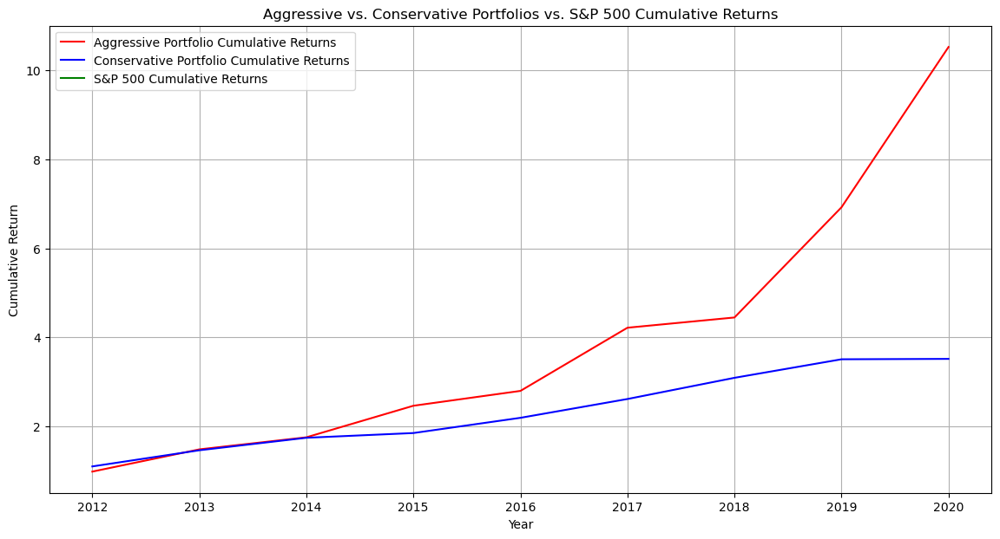

In [55]:
# Plotting
plt.figure(figsize=(14, 7))

# Plot cumulative returns for aggressive and conservative portfolios
plt.plot(annual_returns_filtered.index.year, annual_returns_filtered['Aggressive_Cumulative'], label='Aggressive Portfolio Cumulative Returns', color='red')
plt.plot(annual_returns_filtered.index.year, annual_returns_filtered['Conservative_Cumulative'], label='Conservative Portfolio Cumulative Returns', color='blue')

# Plot S&P 500 cumulative returns
plt.plot(annual_sp500_cumulative_filtered.index.year, annual_sp500_cumulative_filtered, label='S&P 500 Cumulative Returns', color='green')

# Title and labels
plt.title('Aggressive vs. Conservative Portfolios vs. S&P 500 Cumulative Returns')
plt.xlabel('Year')
plt.ylabel('Cumulative Return')
plt.legend()
plt.grid(True)
plt.show()

- #### Compared to Aggressive and Conservative Portfolio Cumulative Returns, <span style="color: red;">S&P 500</span> Index's Cumulative Returns are almost <span style="color: red;">negligible</span>.